<p style="background-color:orange;font-family:newtimeroman;font-size:200%;color:black;text-align:center;border-radius:60px 20px;"><b>ANN - Credit Score Classification Project</b></p>

<b>Contains:</b>
<ul>
    <li><a href="#import-library">Importing Libraries</a></li>
    <li><a href="#loading-dataset">Loading The Dataset</a></li>
    <li><a href="#understand-data">Understanding The Data</a></li>
    <li>
        <a href="#eda">EDA (Exploratory Data Analysis)</a>
        <ul>
            <li><a href="#organizing-columns">Organizing Columns</a></li>
            <li><a href="#nan-values">NaN Values</a></li>
            <li><a href="#outliers">Outliers</a></li>
        </ul>
    </li>
    <li>
        <a href="#modeling">Modeling</a>
        <ul>
            <li><a href="#data-preparation">Data Preparation</a></li>
            <li><a href="#building-ann">Building ANN Architectures</a></li>
        </ul>
    </li>
    <li>
        <a href="#final-model">Final Model & Prediction</a>
        <ul>
            <li><a href="#test-data-preparation">Test Data Preparation</a></li>
            <li><a href="#prediction">Prediction</a></li>
        </ul>
    </li>
    <li><a href="#conclusion">Conclusion</a></li>
</ul>


# <font color='orange'> <b>Introduction</b><font color='black'>  

This project aims to develop an Artificial Neural Network (ANN) model to predict individuals' credit scores based on their financial history. Credit score prediction is a crucial process for banks and financial institutions, as it helps assess individuals' creditworthiness.

In this study, the dataset was analyzed through preprocessing and feature engineering steps, followed by testing various ANN architectures. Different activation functions, layer structures, and hyperparameters were evaluated to achieve the highest accuracy and generalization capability. Finally, the best-performing model was selected, and the results were analyzed.

<a id='import-library'></a>
# <font color='orange'> <b>Importing Libraries</b><font color='black'>  

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import pickle
from skimpy import skim
import missingno as msno

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

import tensorflow as tf
from keras import models
from tensorflow.keras.layers import Dense, Activation, Dropout
from tensorflow.keras.models import Sequential 
from tensorflow.keras.optimizers import Adam 
from tensorflow.keras.callbacks import EarlyStopping

from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import precision_score, recall_score, accuracy_score, classification_report

import warnings
warnings.filterwarnings("ignore")
warnings.warn("this will not show") 

# Set it None to display all rows in the dataframe
pd.set_option('display.max_rows', None)

# Set it to None to display all columns in the dataframe
pd.set_option('display.max_columns', None)

<a id='loading-dataset'></a>
# <font color='orange'> <b>Loading The Dataset</b><font color='black'>  

**About Dataset**:

**ID** : Unique identifier for each record.  
**Customer_ID** : Unique identifier for each customer.  
**Month** : Month of the year.  
**Name** : Name of the individual.  
**Age** : Age of the individual.  
**SSN** : Social Security Number of the individual.  
**Occupation** : Occupation of the individual.  
**Annual_Income** : Annual income of the individual.  
**Monthly_Inhand_Salary** : Monthly net salary of the individual.  
**Num_Bank_Accounts** : Number of bank accounts owned by the individual.  
**Num_Credit_Card** : Number of credit cards owned by the individual.  
**Interest_Rate** : Interest rate on the credit card.  
**Num_of_Loan** : Number of loans taken by the individual.  
**Type_of_Loan** : Types of loans taken by the individual.  
**Delay_from_due_date** : Average number of days payments are delayed past the due date.  
**Num_of_Delayed_Payment** : Total number of delayed payments made by the individual.  
**Changed_Credit_Limit** : Percentage change in the individual's credit card limit.  
**Num_Credit_Inquiries** : Number of credit card inquiries made by the individual.  
**Credit_Mix** : Classification of the individual's credit mix.  
**Outstanding_Debt** : Outstanding debt balance of the individual (in USD).  
**Credit_Utilization_Ratio** : Utilization ratio of the individual's credit card.  
**Credit_History_Age** : Age of the individual's credit history.  
**Payment_of_Min_Amount** : Indicates if the individual pays only the minimum required amount (Yes/No).  
**Total_EMI_per_month** : Total EMI (Equated Monthly Installment) paid by the individual per month (in USD).  
**Amount_invested_monthly** : Monthly amount invested by the individual (in USD).  
**Payment_Behaviour** : Payment behavior of the individual.  
**Monthly_Balance** : Monthly balance remaining in the individual's account (in USD).  
**Credit_Score** : Credit score of the individual ("Poor", "Standard", "Good").  

In [3]:
df0 = pd.read_csv("train.csv")
df = df0.copy()

In [5]:
df_test = pd.read_csv("test.csv")

In [7]:
df.head()

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
0,0x1602,CUS_0xd40,January,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,11.27,4.0,_,809.98,26.822620,22 Years and 1 Months,No,49.574949,80.41529543900253,High_spent_Small_value_payments,312.49408867943663,Good
1,0x1603,CUS_0xd40,February,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",-1,NaN,11.27,4.0,Good,809.98,31.944960,NaN,No,49.574949,118.28022162236736,Low_spent_Large_value_payments,284.62916249607184,Good
2,0x1604,CUS_0xd40,March,Aaron Maashoh,-500,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",3,7,_,4.0,Good,809.98,28.609352,22 Years and 3 Months,No,49.574949,81.699521264648,Low_spent_Medium_value_payments,331.2098628537912,Good
3,0x1605,CUS_0xd40,April,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,NaN,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",5,4,6.27,4.0,Good,809.98,31.377862,22 Years and 4 Months,No,49.574949,199.4580743910713,Low_spent_Small_value_payments,223.45130972736786,Good
4,0x1606,CUS_0xd40,May,Aaron Maashoh,23,821-00-0265,Scientist,19114.12,1824.843333,3,4,3,4,"Auto Loan, Credit-Builder Loan, Personal Loan,...",6,NaN,11.27,4.0,Good,809.98,24.797347,22 Years and 5 Months,No,49.574949,41.420153086217326,High_spent_Medium_value_payments,341.48923103222177,Good


In [9]:
df.sample(3)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score
88272,0x21b3a,CUS_0xa57,January,Krudyh,15,276-37-2086,Manager,51461.4,4305.450000,3,4,16,-100,"Auto Loan, Student Loan, Home Equity Loan, Deb...",13,10,7.54,8.0,Standard,949.81,31.210231,6 Years and 1 Months,Yes,298.896899,37.865922395924905,!@9#%8,333.78217811969887,Standard
63069,0x1878b,CUS_0x8d72,June,Hideyukih,32,200-13-7091,Entrepreneur,63371.56,5533.963333,493,6,8,3,"Personal Loan, Student Loan, and Student Loan",30,21,4.77,7.0,_,756.94,34.416079,27 Years and 1 Months,No,104.869744,61.28823299197998,High_spent_Medium_value_payments,637.2383566434902,Standard
19684,0x8956,CUS_0x19d4,May,NaN,32,999-95-7259,Doctor,22751.59,1759.965833,7,5,12,4,"Credit-Builder Loan, Credit-Builder Loan, Pers...",13,14,6.75,3.0,_,1429.63,25.100880,20 Years and 7 Months,No,38.350282,39.799134969503044,High_spent_Medium_value_payments,347.847166033628,Standard


In [11]:
df_test.sample(3)

,ID,Customer_ID,Month,Name,Age,SSN,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Type_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance
9646,0x8710,CUS_0x7853,November,Tom Berginq,27,329-90-9486,Writer,46010.31,3692.192500,7,8,15,3,"Credit-Builder Loan, Home Equity Loan, and Per...",27,21,7.93,13.0,Bad,1380.78,25.609733,12 Years and 3 Months,Yes,87.482682,34.375149664482144,High_spent_Large_value_payments,487.3614181647729
5447,0x55d9,CUS_0xc04a,December,Jan Strupczewskiv,15,555-02-9736,Entrepreneur,36681.48,2999.790000,7,10,20,6,"Student Loan, Auto Loan, Not Specified, Auto L...",35,15,5.7799999999999985,15.0,Standard,2352.66,23.851849,9 Years and 0 Months,Yes,153.107492,224.77595676271676,Low_spent_Large_value_payments,192.09555138127868
25071,0x13bd1,CUS_0x39e5,December,NaN,17_,378-91-8909,_______,19895.9,1384.991667,5,9,34,5,"Credit-Builder Loan, Not Specified, Credit-Bui...",35,12,19.44,NaN,_,2600.04,37.665390,14 Years and 4 Months,Yes,66.388434,95.29581804073315,!@9#%8,236.81491449896558


<a id='understand-data'></a>
# <font color='orange'> <b>Understanding The Data</b><font color='black'>  

In [13]:
print("Train dataset shape:", df.shape)
print("Test dataset shape: ", df_test.shape)

Train dataset shape: (100000, 28)
Test dataset shape:  (50000, 27)


In [17]:
print("Total number of duplicated rows in train data:", df.duplicated().sum())
print("Total number of duplicated rows in test data: ", df_test.duplicated().sum())

Total number of duplicated rows in train data: 0
Total number of duplicated rows in test data:  0


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 28 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ID                        100000 non-null  object 
 1   Customer_ID               100000 non-null  object 
 2   Month                     100000 non-null  object 
 3   Name                      90015 non-null   object 
 4   Age                       100000 non-null  object 
 5   SSN                       100000 non-null  object 
 6   Occupation                100000 non-null  object 
 7   Annual_Income             100000 non-null  object 
 8   Monthly_Inhand_Salary     84998 non-null   float64
 9   Num_Bank_Accounts         100000 non-null  int64  
 10  Num_Credit_Card           100000 non-null  int64  
 11  Interest_Rate             100000 non-null  int64  
 12  Num_of_Loan               100000 non-null  object 
 13  Type_of_Loan              88592 non-null   ob

In [21]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 27 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   ID                        50000 non-null  object 
 1   Customer_ID               50000 non-null  object 
 2   Month                     50000 non-null  object 
 3   Name                      44985 non-null  object 
 4   Age                       50000 non-null  object 
 5   SSN                       50000 non-null  object 
 6   Occupation                50000 non-null  object 
 7   Annual_Income             50000 non-null  object 
 8   Monthly_Inhand_Salary     42502 non-null  float64
 9   Num_Bank_Accounts         50000 non-null  int64  
 10  Num_Credit_Card           50000 non-null  int64  
 11  Interest_Rate             50000 non-null  int64  
 12  Num_of_Loan               50000 non-null  object 
 13  Type_of_Loan              44296 non-null  object 
 14  Delay_

In [13]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Monthly_Inhand_Salary,84998.0,4194.170850,3183.686167,303.645417,1625.568229,3093.745000,5957.448333,15204.633333
Num_Bank_Accounts,100000.0,17.091280,117.404834,-1.000000,3.000000,6.000000,7.000000,1798.000000
Num_Credit_Card,100000.0,22.474430,129.057410,0.000000,4.000000,5.000000,7.000000,1499.000000
Interest_Rate,100000.0,72.466040,466.422621,1.000000,8.000000,13.000000,20.000000,5797.000000
Delay_from_due_date,100000.0,21.068780,14.860104,-5.000000,10.000000,18.000000,28.000000,67.000000
Num_Credit_Inquiries,98035.0,27.754251,193.177339,0.000000,3.000000,6.000000,9.000000,2597.000000
Credit_Utilization_Ratio,100000.0,32.285173,5.116875,20.000000,28.052567,32.305784,36.496663,50.000000
Total_EMI_per_month,100000.0,1403.118217,8306.041270,0.000000,30.306660,69.249473,161.224249,82331.000000


In [14]:
df.describe(include="object").T

,count,unique,top,freq
ID,100000,100000,0x1602,1
Customer_ID,100000,12500,CUS_0xd40,8
Month,100000,8,January,12500
Name,90015,10139,Langep,44
Age,100000,1788,38,2833
SSN,100000,12501,#F%$D@*&8,5572
Occupation,100000,16,_______,7062
Annual_Income,100000,18940,36585.12,16
Num_of_Loan,100000,434,3,14386
Type_of_Loan,88592,6260,Not Specified,1408


In [15]:
skim(df)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 100000 │ │ string      │ 19    │                                                          │
│ │ Number of columns │ 27     │ │ float64     │ 4     │                                                          │
│ └───────────────────┴────────┘ │ int32       │ 4     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_name            ┃ NA     ┃ NA %  ┃ mean   ┃ sd     ┃ p0    ┃ p25   ┃ p50   ┃ p75   ┃ p100  ┃ hist   ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━┩  │
│ │ Monthly_Inhand_Salary  │  15002 │    15 │   4194 │   3184 │ 303.6 │  1626 │  3094 │  5957 │ 15200 │ ▇▅▃▁▁  │  │
│ │ Num_Bank_Accounts      │      0 │     0 │  17.09 │  117.4 │    -1 │     3 │     6 │     7 │  1798 │   ▇    │  │
│ │ Num_Credit_Card        │      0 │     0 │  22.47 │  129.1 │     0 │     4 │     5 │     7 │  1499 │   ▇    │  │
│ │ Interest_Rate          │      0 │     0 │  72.47 │  466.4 │     1 │     8 │    13 │    20 │  5797 │   ▇    │  │
│ │ Delay_from_due_date    │      0 │     0 │  21.07 │  14.86 │    -5 │    10 │    18 │    28 │    67 │ ▃▇▆▂▁▁ │  │
│ │ Num_Credit_Inquiries   │   1965 │  1.96 │  27.75 │  193.2 │     0 │     3 │     6 │     9 │  2597 │   ▇    │  │
│ │ Credit_Utilization_Rat │      0 │     0 │  32.29 │  5.117 │    20 │ 28.05 │ 32.31 │  36.5 │    50 │ ▂▇▇▇▂  │  │
│ │ io                     │        │       │        │        │       │       │       │       │       │        │  │
│ │ Total_EMI_per_month    │      0 │     0 │   1403 │   8306 │     0 │ 30.31 │ 69.25 │ 161.2 │ 82330 │   ▇    │  │
│ └────────────────────────┴────────┴───────┴────────┴────────┴───────┴───────┴───────┴───────┴───────┴────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                        ┃ NA         ┃ NA %       ┃ words per row          ┃ total words        ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━┩  │
│ │ ID                                 │          0 │          0 │                      1 │             100000 │  │
│ │ Customer_ID                        │          0 │          0 │                      1 │             100000 │  │
│ │ Month                              │          0 │          0 │                      1 │             100000 │  │
│ │ Name                               │       9985 │       9.98 │                    1.3 │             125713 │  │
│ │ Age                                │          0 │          0 │                      1 │             100000 │  │
│ │ SSN                                │          0 │          0 │                      1 │             100000 │  │
│ │ Occupation                         │          0 │          0 │                      1 │             100000 │  │
│ │ Annual_Income                      │          0 │   

In [25]:
skim(df_test)

╭──────────────────────────────────────────────── skimpy summary ─────────────────────────────────────────────────╮
│          Data Summary                Data Types                                                                 │
│ ┏━━━━━━━━━━━━━━━━━━━┳━━━━━━━━┓ ┏━━━━━━━━━━━━━┳━━━━━━━┓                                                          │
│ ┃ dataframe         ┃ Values ┃ ┃ Column Type ┃ Count ┃                                                          │
│ ┡━━━━━━━━━━━━━━━━━━━╇━━━━━━━━┩ ┡━━━━━━━━━━━━━╇━━━━━━━┩                                                          │
│ │ Number of rows    │ 50000  │ │ string      │ 19    │                                                          │
│ │ Number of columns │ 27     │ │ float64     │ 4     │                                                          │
│ └───────────────────┴────────┘ │ int32       │ 4     │                                                          │
│                                └─────────────┴───────┘                                                          │
│                                                     number                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━┳━━━━━━━━┓  │
│ ┃ column_name            ┃ NA    ┃ NA %  ┃ mean   ┃ sd     ┃ p0     ┃ p25   ┃ p50   ┃ p75   ┃ p100  ┃ hist   ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━╇━━━━━━━━┩  │
│ │ Monthly_Inhand_Salary  │  7498 │    15 │   4182 │   3174 │  303.6 │  1625 │  3086 │  5934 │ 15200 │ ▇▅▃▁▁  │  │
│ │ Num_Bank_Accounts      │     0 │     0 │  16.84 │  116.4 │     -1 │     3 │     6 │     7 │  1798 │   ▇    │  │
│ │ Num_Credit_Card        │     0 │     0 │  22.92 │  129.3 │      0 │     4 │     5 │     7 │  1499 │   ▇    │  │
│ │ Interest_Rate          │     0 │     0 │  68.77 │  451.6 │      1 │     8 │    13 │    20 │  5799 │   ▇    │  │
│ │ Delay_from_due_date    │     0 │     0 │  21.05 │  14.86 │     -5 │    10 │    18 │    28 │    67 │ ▃▇▆▂▁▁ │  │
│ │ Num_Credit_Inquiries   │  1035 │  2.07 │  30.08 │    197 │      0 │     4 │     7 │    10 │  2593 │   ▇    │  │
│ │ Credit_Utilization_Rat │     0 │     0 │  32.28 │  5.106 │  20.51 │ 28.06 │ 32.28 │ 36.47 │ 48.54 │ ▃▇▇▇▃  │  │
│ │ io                     │       │       │        │        │        │       │       │       │       │        │  │
│ │ Total_EMI_per_month    │     0 │     0 │   1491 │   8596 │      0 │ 32.22 │ 74.73 │ 176.2 │ 82400 │   ▇    │  │
│ └────────────────────────┴───────┴───────┴────────┴────────┴────────┴───────┴───────┴───────┴───────┴────────┘  │
│                                                     string                                                      │
│ ┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━┓  │
│ ┃ column_name                         ┃ NA       ┃ NA %       ┃ words per row           ┃ total words        ┃  │
│ ┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━┩  │
│ │ ID                                  │        0 │          0 │                       1 │              50000 │  │
│ │ Customer_ID                         │        0 │          0 │                       1 │              50000 │  │
│ │ Month                               │        0 │          0 │                       1 │              50000 │  │
│ │ Name                                │     5015 │      10.03 │                     1.3 │              62810 │  │
│ │ Age                                 │        0 │          0 │                       1 │              50000 │  │
│ │ SSN                                 │        0 │          0 │                       1 │              50000 │  │
│ │ Occupation                          │        0 │          0 │                       1 │              50000 │  │
│ │ Annual_Income                       │        0 │    

In [16]:
df.isnull().sum()

ID                              0
Customer_ID                     0
Month                           0
Name                         9985
Age                             0
SSN                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary       15002
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Type_of_Loan                11408
Delay_from_due_date             0
Num_of_Delayed_Payment       7002
Changed_Credit_Limit            0
Num_Credit_Inquiries         1965
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Credit_History_Age           9030
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly      4479
Payment_Behaviour               0
Monthly_Balance              1200
Credit_Score                    0
dtype: int64

In [27]:
df_test.isnull().sum()

ID                             0
Customer_ID                    0
Month                          0
Name                        5015
Age                            0
SSN                            0
Occupation                     0
Annual_Income                  0
Monthly_Inhand_Salary       7498
Num_Bank_Accounts              0
Num_Credit_Card                0
Interest_Rate                  0
Num_of_Loan                    0
Type_of_Loan                5704
Delay_from_due_date            0
Num_of_Delayed_Payment      3498
Changed_Credit_Limit           0
Num_Credit_Inquiries        1035
Credit_Mix                     0
Outstanding_Debt               0
Credit_Utilization_Ratio       0
Credit_History_Age          4470
Payment_of_Min_Amount          0
Total_EMI_per_month            0
Amount_invested_monthly     2271
Payment_Behaviour              0
Monthly_Balance              562
dtype: int64

<a id='eda'></a>
# <font color='orange'> <b>EDA (Exploratory Data Analysis)</b><font color='black'>  

**Columns to Drop**

1. **ID**: Unique identifier for each record, carries no useful information for the model.  
2. **Customer_ID**: Unique identifier for each customer, not related to the target variable.  
3. **Name**: The name of the individual, does not provide meaningful input for the model.  
4. **SSN**: Social Security Number, a unique identifier that is irrelevant to prediction.  
5. **Type_of_Loan**: Likely a categorical list (e.g., types of loans). Unless encoded appropriately, this is not useful for ANN.  
6. **Payment_Behaviour**: May contain text-based or categorical data, which is hard to use meaningfully without proper encoding. Can be dropped unless processed.  

---

**Columns Requiring Further Processing**

- **Credit_History_Age**: This column contains values like "5 Years and 3 Months," which need to be converted into a numeric format for use in ANN.  
- **Credit_Mix**: If not already numeric, this column must be encoded (e.g., one-hot encoding or label encoding).  
- **Occupation**: This column should be encoded to be usable by the model.  
- **Month**: If the month is unrelated to the target variable, it can also be dropped. 

In [29]:
# Dropping unnecessary columns for model
df.drop(columns= ["ID", "Customer_ID", "Name", "SSN", "Type_of_Loan"], inplace=True)
df_test.drop(columns= ["ID", "Customer_ID", "Name", "SSN", "Type_of_Loan"], inplace=True)

<a id='organizing-columns'></a>
## <font color='gold'> <b>Organizing Columns</b><font color='black'>  

### <font color='sandybrown'> <b>"Month" Column</b><font color='black'>  

In [31]:
df.Month.unique()

array(['January', 'February', 'March', 'April', 'May', 'June', 'July',
       'August'], dtype=object)

In [33]:
df_test.Month.unique()

array(['September', 'October', 'November', 'December'], dtype=object)

In [35]:
month_mapping = {
    'January': 1,
    'February': 2,
    'March': 3,
    'April': 4,
    'May': 5,
    'June': 6,
    'July': 7,
    'August': 8
}
df['Month'] = df['Month'].map(month_mapping)

In [37]:
month_mapping = {
    'September': 9,
    'October': 10,
    'November': 11,
    'December': 12
}
df_test['Month'] = df_test['Month'].map(month_mapping)

In [25]:
df.Month.dtype

dtype('int64')

### <font color='sandybrown'> <b>"Age" Column</b><font color='black'>  

In [27]:
df.Age.nunique()

1788

In [28]:
df.Age.unique()

array(['23', '-500', '28_', ..., '4808_', '2263', '1342'], dtype=object)

There are some signs like "-" and "_" in Age column. Let's correct them.

In [39]:
df["Age"] = df["Age"].str.replace("-", "").str.replace("_", "")
df_test["Age"] = df_test["Age"].str.replace("-", "").str.replace("_", "")

In [41]:
df["Age"] = df.Age.astype("int")
df_test["Age"] = df_test.Age.astype("int")

### <font color='sandybrown'> <b>"Occupation" Column</b><font color='black'>  

In [33]:
df.Occupation.nunique()

16

In [34]:
df.Occupation.unique()

array(['Scientist', '_______', 'Teacher', 'Engineer', 'Entrepreneur',
       'Developer', 'Lawyer', 'Media_Manager', 'Doctor', 'Journalist',
       'Manager', 'Accountant', 'Musician', 'Mechanic', 'Writer',
       'Architect'], dtype=object)

In [43]:
df["Occupation"] = df["Occupation"].str.replace("_______", "")
df_test["Occupation"] = df_test["Occupation"].str.replace("_______", "")

In [45]:
df["Occupation"] = df.Occupation.astype("category")
df_test["Occupation"] = df_test.Occupation.astype("category")

### <font color='sandybrown'> <b>"Annual_Income" Column</b><font color='black'>  

In [38]:
df.Annual_Income.nunique()

18940

In [39]:
df.Annual_Income.unique()

array(['19114.12', '34847.84', '34847.84_', ..., '20002.88', '39628.99',
       '39628.99_'], dtype=object)

In [47]:
df["Annual_Income"] = df.Annual_Income.str.replace("_", "")
df_test["Annual_Income"] = df_test.Annual_Income.str.replace("_", "")

In [49]:
df["Annual_Income"] = df.Annual_Income.astype("float")
df_test["Annual_Income"] = df_test.Annual_Income.astype("float")

### <font color='sandybrown'> <b>"Monthly_Inhand_Salary" Column</b><font color='black'>  

In [43]:
df.Monthly_Inhand_Salary.nunique()

13235

In [44]:
df.Monthly_Inhand_Salary.unique()

array([1824.84333333,           nan, 3037.98666667, ..., 3097.00833333,
       1929.90666667, 3359.41583333])

In [45]:
df.Monthly_Inhand_Salary.dtype

dtype('float64')

This column seems OK for now. NaN values will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Num_Bank_Accounts" Column</b><font color='black'>  

In [48]:
df.Num_Bank_Accounts.nunique()

943

In [49]:
df.Num_Bank_Accounts.dtype

dtype('int64')

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Num_Credit_Card" Column</b><font color='black'>  

In [52]:
df.Num_Credit_Card.nunique()

1179

In [53]:
df.Num_Credit_Card.dtype

dtype('int64')

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Interest_Rate" Column</b><font color='black'>  

In [56]:
df.Interest_Rate.nunique()

1750

In [57]:
df.Interest_Rate.dtype

dtype('int64')

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Num_of_Loan" Column</b><font color='black'>  

In [60]:
df.Num_of_Loan.nunique()

434

In [61]:
df.Num_of_Loan.dtype

dtype('O')

In [62]:
df.Num_of_Loan.unique()

array(['4', '1', '3', '967', '-100', '0', '0_', '2', '3_', '2_', '7', '5',
       '5_', '6', '8', '8_', '9', '9_', '4_', '7_', '1_', '1464', '6_',
       '622', '352', '472', '1017', '945', '146', '563', '341', '444',
       '720', '1485', '49', '737', '1106', '466', '728', '313', '843',
       '597_', '617', '119', '663', '640', '92_', '1019', '501', '1302',
       '39', '716', '848', '931', '1214', '186', '424', '1001', '1110',
       '1152', '457', '1433', '1187', '52', '1480', '1047', '1035',
       '1347_', '33', '193', '699', '329', '1451', '484', '132', '649',
       '995', '545', '684', '1135', '1094', '1204', '654', '58', '348',
       '614', '1363', '323', '1406', '1348', '430', '153', '1461', '905',
       '1312', '1424', '1154', '95', '1353', '1228', '819', '1006', '795',
       '359', '1209', '590', '696', '1185_', '1465', '911', '1181', '70',
       '816', '1369', '143', '1416', '455', '55', '1096', '1474', '420',
       '1131', '904', '89', '1259', '527', '1241', '449', 

In [51]:
df["Num_of_Loan"] = df.Num_of_Loan.str.replace("_", "")
df_test["Num_of_Loan"] = df_test.Num_of_Loan.str.replace("_", "")

In [53]:
df["Num_of_Loan"] = df.Num_of_Loan.astype("int")
df_test["Num_of_Loan"] = df_test.Num_of_Loan.astype("int")

### <font color='sandybrown'> <b>"Delay_from_due_date" Column</b><font color='black'>  

In [66]:
df.Delay_from_due_date.nunique()

73

In [67]:
df.Delay_from_due_date.unique()

array([ 3, -1,  5,  6,  8,  7, 13, 10,  0,  4,  9,  1, 12, 11, 30, 31, 34,
       27, 14,  2, -2, 16, 17, 15, 23, 22, 21, 18, 19, 52, 51, 48, 53, 26,
       43, 28, 25, 20, 47, 46, 49, 24, 61, 29, 50, 58, 45, 59, 55, 56, 57,
       54, 62, 65, 64, 67, 36, 41, 33, 32, 39, 44, 42, 60, 35, 38, -3, 63,
       40, 37, -5, -4, 66], dtype=int64)

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Num_of_Delayed_Payment" Column</b><font color='black'>  

In [70]:
df.Num_of_Delayed_Payment.nunique()

749

In [116]:
df.Num_of_Delayed_Payment.unique()

array(['7', nan, '4', '8_', '6', '1', '-1', '3_', '0', '8', '5', '3', '9',
       '12', '15', '17', '10', '2', '2_', '11', '14', '20', '22', '13',
       '13_', '14_', '16', '12_', '18', '19', '23', '24', '21', '3318',
       '3083', '22_', '1338', '4_', '26', '11_', '3104', '21_', '25',
       '10_', '183_', '9_', '1106', '834', '19_', '24_', '17_', '23_',
       '2672', '20_', '2008', '-3', '538', '6_', '1_', '16_', '27', '-2',
       '3478', '2420', '15_', '707', '708', '26_', '18_', '3815', '28',
       '5_', '1867', '2250', '1463', '25_', '7_', '4126', '2882', '1941',
       '2655', '2628', '132', '3069', '306', '0_', '3539', '3684', '1823',
       '4128', '1946', '827', '2297', '2566', '904', '182', '929', '3568',
       '2503', '1552', '2812', '1697', '3764', '851', '3905', '923', '88',
       '1668', '3253', '808', '2689', '3858', '642', '3457', '1402',
       '1732', '3154', '847', '3037', '2204', '3103', '1063', '2056',
       '1282', '1841', '2569_', '211', '793', '3484', '4

In [55]:
df["Num_of_Delayed_Payment"] = df.Num_of_Delayed_Payment.str.replace("_", "").str.replace("-", "")
df_test["Num_of_Delayed_Payment"] = df_test.Num_of_Delayed_Payment.str.replace("_", "").str.replace("-", "")

In [57]:
df["Num_of_Delayed_Payment"] = df.Num_of_Delayed_Payment.astype("float")
df_test["Num_of_Delayed_Payment"] = df_test.Num_of_Delayed_Payment.astype("float")

### <font color='sandybrown'> <b>"Changed_Credit_Limit" Column</b><font color='black'>  

In [122]:
df.Changed_Credit_Limit.nunique()

4384

In [123]:
df.Changed_Credit_Limit.unique()

array(['11.27', '_', '6.27', ..., '17.509999999999998', '25.16', '21.17'],
      dtype=object)

In [60]:
df["Changed_Credit_Limit"] = df["Changed_Credit_Limit"].str.replace("_", "")
df["Changed_Credit_Limit"] = df["Changed_Credit_Limit"].replace("", np.nan)

df_test["Changed_Credit_Limit"] = df_test["Changed_Credit_Limit"].str.replace("_", "")
df_test["Changed_Credit_Limit"] = df_test["Changed_Credit_Limit"].replace("", np.nan)

In [62]:
df["Changed_Credit_Limit"] = df["Changed_Credit_Limit"].astype("float")
df_test["Changed_Credit_Limit"] = df_test["Changed_Credit_Limit"].astype("float")

### <font color='sandybrown'> <b>"Num_Credit_Inquiries" Column</b><font color='black'>  

In [127]:
df.Num_Credit_Inquiries.nunique()

1223

In [128]:
df.Num_Credit_Inquiries.dtype

dtype('float64')

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Credit_Mix" Column</b><font color='black'>  

In [131]:
df.Credit_Mix.nunique()

4

In [132]:
df.Credit_Mix.unique()

array(['_', 'Good', 'Standard', 'Bad'], dtype=object)

In [64]:
df["Credit_Mix"] = df["Credit_Mix"].str.replace("_", "")
df["Credit_Mix"] = df["Credit_Mix"].replace("", np.nan)

df_test["Credit_Mix"] = df_test["Credit_Mix"].str.replace("_", "")
df_test["Credit_Mix"] = df_test["Credit_Mix"].replace("", np.nan)

### <font color='sandybrown'> <b>"Outstanding_Debt" Column</b><font color='black'>  

In [135]:
df.Outstanding_Debt.nunique()

13178

In [136]:
df.Outstanding_Debt.dtype

dtype('O')

In [137]:
df.Outstanding_Debt.unique()

array(['809.98', '605.03', '1303.01', ..., '3571.7_', '3571.7', '502.38'],
      dtype=object)

In [66]:
df["Outstanding_Debt"] = df["Outstanding_Debt"].str.replace("_", "")
df_test["Outstanding_Debt"] = df_test["Outstanding_Debt"].str.replace("_", "")

In [68]:
df["Outstanding_Debt"] = df["Outstanding_Debt"].astype("float")
df_test["Outstanding_Debt"] = df_test["Outstanding_Debt"].astype("float")

### <font color='sandybrown'> <b>"Credit_Utilization_Ratio" Column</b><font color='black'>  

In [141]:
df.Credit_Utilization_Ratio.nunique()

100000

In [142]:
df.Credit_Utilization_Ratio.dtype

dtype('float64')

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Credit_History_Age" Column</b><font color='black'>  

In [145]:
df.Credit_History_Age.nunique()

404

In [146]:
df.Credit_History_Age.unique()[2]

'22 Years and 3 Months'

In [76]:
# Converting years to months
def convert_to_months(age_str):
    # Check if the value is not NaN and is a string
    if isinstance(age_str, str):
        # Splitting 'Years and Months' into 'x Years and y Months'
        years, months = 0, 0
        if 'Years' in age_str:
            years = int(age_str.split('Years')[0].strip())
        if 'Months' in age_str:
            months = int(age_str.split('Months')[0].split('and')[1].strip())

        # Calculating the month equivalent of the year and converting the total months
        total_months = (years * 12) + months
        return total_months
    else:
        # If it's NaN or not a string, return NaN
        return np.nan

# Applying
df['Credit_History_Age_in_months'] = df['Credit_History_Age'].apply(convert_to_months)

# Checking
df[['Credit_History_Age', 'Credit_History_Age_in_months']].sample(3)

,Credit_History_Age,Credit_History_Age_in_months
41778,8 Years and 3 Months,99.0
53401,11 Years and 3 Months,135.0
75933,28 Years and 3 Months,339.0


In [78]:
df_test['Credit_History_Age_in_months'] = df_test['Credit_History_Age'].apply(convert_to_months)

In [80]:
df.drop(columns= ["Credit_History_Age"], inplace=True)
df_test.drop(columns= ["Credit_History_Age"], inplace=True)

### <font color='sandybrown'> <b>"Payment_of_Min_Amount" Column</b><font color='black'>  

In [150]:
df.Payment_of_Min_Amount.nunique()

3

In [151]:
df.Payment_of_Min_Amount.unique()

array(['No', 'NM', 'Yes'], dtype=object)

**'NM'** can mean **"Not Made"** or **"Not Mentioned"**. So, let's turn NM into No.

In [82]:
df["Payment_of_Min_Amount"] = df.Payment_of_Min_Amount.str.replace("NM", "No")
df_test["Payment_of_Min_Amount"] = df_test.Payment_of_Min_Amount.str.replace("NM", "No")

In [84]:
df["Payment_of_Min_Amount"] = df.Payment_of_Min_Amount.astype("category")
df_test["Payment_of_Min_Amount"] = df_test.Payment_of_Min_Amount.astype("category")

### <font color='sandybrown'> <b>"Total_EMI_per_month" Column</b><font color='black'>  

In [156]:
df.Total_EMI_per_month.nunique()

14950

In [157]:
df.Total_EMI_per_month.dtype

dtype('float64')

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

### <font color='sandybrown'> <b>"Amount_invested_monthly" Column</b><font color='black'>  

In [160]:
df.Amount_invested_monthly.nunique()

91049

In [161]:
df.Amount_invested_monthly.dtype

dtype('O')

In [162]:
df.Amount_invested_monthly.unique()

array(['80.41529543900253', '118.28022162236736', '81.699521264648', ...,
       '24.02847744864441', '251.67258219721603', '167.1638651610451'],
      dtype=object)

In [163]:
df.Amount_invested_monthly[18]

'__10000__'

In [86]:
df["Amount_invested_monthly"] = df.Amount_invested_monthly.str.strip("_")
df["Amount_invested_monthly"] = df.Amount_invested_monthly.astype("float")

df_test["Amount_invested_monthly"] = df_test.Amount_invested_monthly.str.strip("_")
df_test["Amount_invested_monthly"] = df_test.Amount_invested_monthly.astype("float")

### <font color='sandybrown'> <b>"Payment_Behaviour" Column</b><font color='black'>  

In [166]:
df.Payment_Behaviour.nunique()

7

In [167]:
df.Payment_Behaviour.unique()

array(['High_spent_Small_value_payments',
       'Low_spent_Large_value_payments',
       'Low_spent_Medium_value_payments',
       'Low_spent_Small_value_payments',
       'High_spent_Medium_value_payments', '!@9#%8',
       'High_spent_Large_value_payments'], dtype=object)

In [88]:
df["Payment_Behaviour"] = df.Payment_Behaviour.str.replace("!@9#%8", "")
df["Payment_Behaviour"] = df.Payment_Behaviour.replace("", np.nan)

df_test["Payment_Behaviour"] =df_test.Payment_Behaviour.str.replace("!@9#%8", "")
df_test["Payment_Behaviour"] = df_test.Payment_Behaviour.replace("", np.nan)

### <font color='sandybrown'> <b>"Monthly_Balance" Column</b><font color='black'>  

In [170]:
df.Monthly_Balance.nunique()

98792

In [171]:
df.Monthly_Balance.dtype

dtype('O')

In [90]:
df["Monthly_Balance"] = df.Monthly_Balance.str.strip("_")
df["Monthly_Balance"] = df.Monthly_Balance.astype("float")

df_test["Monthly_Balance"] = df_test.Monthly_Balance.str.strip("_")
df_test["Monthly_Balance"] = df_test.Monthly_Balance.astype("float")

In [92]:
df['Monthly_Balance'] = df['Monthly_Balance'].apply(lambda x: "{:.3f}".format(x))
df_test['Monthly_Balance'] = df_test['Monthly_Balance'].apply(lambda x: "{:.3f}".format(x))

### <font color='sandybrown'> <b>"Credit_Score" Column</b><font color='black'>  

In [175]:
df.Credit_Score.nunique()

3

In [176]:
df.Credit_Score.unique()

array(['Good', 'Standard', 'Poor'], dtype=object)

This column seems OK for now. If there are NaN values, they will be handled in **NaN Values** section.

In [178]:
# checking dtypes
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 23 columns):
 #   Column                        Non-Null Count   Dtype   
---  ------                        --------------   -----   
 0   Month                         100000 non-null  int64   
 1   Age                           100000 non-null  int32   
 2   Occupation                    100000 non-null  category
 3   Annual_Income                 100000 non-null  float64 
 4   Monthly_Inhand_Salary         84998 non-null   float64 
 5   Num_Bank_Accounts             100000 non-null  int64   
 6   Num_Credit_Card               100000 non-null  int64   
 7   Interest_Rate                 100000 non-null  int64   
 8   Num_of_Loan                   100000 non-null  int32   
 9   Delay_from_due_date           100000 non-null  int64   
 10  Num_of_Delayed_Payment        92998 non-null   float64 
 11  Changed_Credit_Limit          97909 non-null   float64 
 12  Num_Credit_Inquiries          9

In [94]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 22 columns):
 #   Column                        Non-Null Count  Dtype   
---  ------                        --------------  -----   
 0   Month                         50000 non-null  int64   
 1   Age                           50000 non-null  int32   
 2   Occupation                    50000 non-null  category
 3   Annual_Income                 50000 non-null  float64 
 4   Monthly_Inhand_Salary         42502 non-null  float64 
 5   Num_Bank_Accounts             50000 non-null  int64   
 6   Num_Credit_Card               50000 non-null  int64   
 7   Interest_Rate                 50000 non-null  int64   
 8   Num_of_Loan                   50000 non-null  int32   
 9   Delay_from_due_date           50000 non-null  int64   
 10  Num_of_Delayed_Payment        46502 non-null  float64 
 11  Changed_Credit_Limit          48941 non-null  float64 
 12  Num_Credit_Inquiries          48965 non-null  

In [96]:
# saving version-1 of data
df.to_csv("data_v1.csv", index=False)
df_test.to_csv("testdata_v1.csv", index=False)

In [3]:
df = pd.read_csv("data_v1.csv")
df.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,Credit_History_Age_in_months
0,1,23,Scientist,19114.12,1824.843333,3,4,3,4,3,7.0,11.27,4.0,NaN,809.98,26.822620,No,49.574949,80.415295,High_spent_Small_value_payments,312.494,Good,265.0
1,2,23,Scientist,19114.12,NaN,3,4,3,4,-1,NaN,11.27,4.0,Good,809.98,31.944960,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629,Good,NaN
2,3,500,Scientist,19114.12,NaN,3,4,3,4,3,7.0,NaN,4.0,Good,809.98,28.609352,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.210,Good,267.0
3,4,23,Scientist,19114.12,NaN,3,4,3,4,5,4.0,6.27,4.0,Good,809.98,31.377862,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451,Good,268.0
4,5,23,Scientist,19114.12,1824.843333,3,4,3,4,6,NaN,11.27,4.0,Good,809.98,24.797347,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489,Good,269.0


<a id='nan-values'></a>
## <font color='gold'> <b>NaN Values</b><font color='black'>  

In [5]:
df.isnull().sum()

Month                               0
Age                                 0
Occupation                       7062
Annual_Income                       0
Monthly_Inhand_Salary           15002
Num_Bank_Accounts                   0
Num_Credit_Card                     0
Interest_Rate                       0
Num_of_Loan                         0
Delay_from_due_date                 0
Num_of_Delayed_Payment           7002
Changed_Credit_Limit             2091
Num_Credit_Inquiries             1965
Credit_Mix                      20195
Outstanding_Debt                    0
Credit_Utilization_Ratio            0
Payment_of_Min_Amount               0
Total_EMI_per_month                 0
Amount_invested_monthly          4479
Payment_Behaviour                7600
Monthly_Balance                  2868
Credit_Score                        0
Credit_History_Age_in_months     9030
dtype: int64

In [6]:
df.isnull().sum().sum()

77294

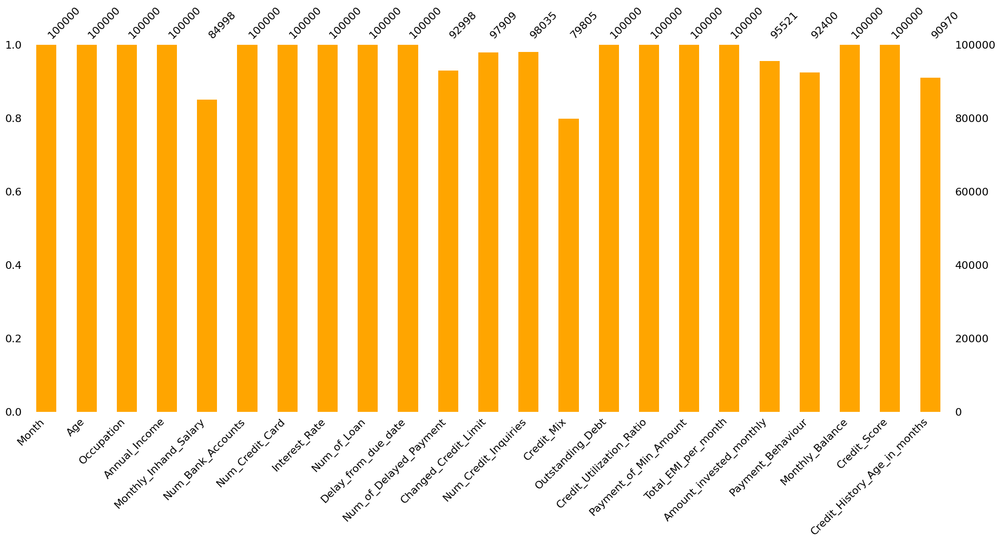

In [150]:
msno.bar(df, color="orange");

### <font color='sandybrown'> <b>NaN Values in "Occupation" Column</b><font color='black'>  

In [9]:
df.Occupation.isnull().sum()

7062

In [10]:
df.Occupation.unique()

array(['Scientist', nan, 'Teacher', 'Engineer', 'Entrepreneur',
       'Developer', 'Lawyer', 'Media_Manager', 'Doctor', 'Journalist',
       'Manager', 'Accountant', 'Musician', 'Mechanic', 'Writer',
       'Architect'], dtype=object)

In [11]:
df['Occupation'].mode()[0]

'Lawyer'

In [12]:
occupation_mode = df['Occupation'].mode()[0]

def fill_mode(x):
    mode_value = x.mode()
    return x.fillna(mode_value[0] if not mode_value.empty else occupation_mode)

df['Occupation'] = df.groupby('Annual_Income')['Occupation'].transform(fill_mode)

In [13]:
df.Occupation.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Monthly_Inhand_Salary" Column</b><font color='black'>  

In [15]:
df.Monthly_Inhand_Salary.isnull().sum()

15002

In [16]:
df['Monthly_Inhand_Salary'].fillna(df['Annual_Income'] / 12, inplace=True)

In [17]:
df.Monthly_Inhand_Salary.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Num_of_Delayed_Payment" Column</b><font color='black'>  

In [19]:
df.Num_of_Delayed_Payment.isnull().sum()

7002

In [20]:
df['Num_of_Delayed_Payment'] = df.groupby('Credit_Score')['Num_of_Delayed_Payment'].transform(lambda x: x.fillna(x.mean()))

In [21]:
df.Num_of_Delayed_Payment.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Changed_Credit_Limit" Column</b><font color='black'>  

In [23]:
df.Changed_Credit_Limit.isnull().sum()

2091

In [24]:
df['Changed_Credit_Limit'] = df.groupby(['Credit_Score', 'Annual_Income'])['Changed_Credit_Limit'].transform(lambda x: x.fillna(x.mean()))

In [25]:
df.Changed_Credit_Limit.isnull().sum()

68

In [26]:
df['Changed_Credit_Limit'].fillna(df['Changed_Credit_Limit'].median(), inplace=True)

In [27]:
df.Changed_Credit_Limit.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Num_Credit_Inquiries" Column</b><font color='black'>  

In [29]:
df.Num_Credit_Inquiries.isnull().sum()

1965

In [30]:
df['Num_Credit_Inquiries'] = df.groupby(['Credit_Score', 'Age', 'Annual_Income'])['Num_Credit_Inquiries'].transform(lambda x: x.fillna(x.mean()))

In [31]:
df.Num_Credit_Inquiries.isnull().sum()

192

In [32]:
df['Num_Credit_Inquiries'].fillna(df['Num_Credit_Inquiries'].median(), inplace=True)

In [33]:
df.Num_Credit_Inquiries.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Credit_Mix" Column</b><font color='black'>  

In [35]:
df.Credit_Mix.isnull().sum()

20195

In [36]:
creditMix_mode = df.Credit_Mix.mode()[0]
df['Credit_Mix'] = df.groupby('Credit_Score')['Credit_Mix'].transform(lambda x: x.fillna(x.mode()[0] if not x.mode().empty else creditMix_mode))

In [37]:
df.Credit_Mix.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Amount_invested_monthly" Column</b><font color='black'>  

In [39]:
df.Amount_invested_monthly.isnull().sum()

4479

In [40]:
df['Amount_invested_monthly'] = df.groupby(['Annual_Income', 'Monthly_Inhand_Salary'])['Amount_invested_monthly'].transform(lambda x: x.fillna(x.median()))

In [41]:
df.Amount_invested_monthly.isnull().sum()

296

In [42]:
df['Amount_invested_monthly'].fillna(df.Amount_invested_monthly.median(), inplace=True)

In [43]:
df.Amount_invested_monthly.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Payment_Behaviour" Column</b><font color='black'>  

In [45]:
df.Payment_Behaviour.isnull().sum()

7600

In [46]:
pb_mode = df['Payment_Behaviour'].mode()[0]

df['Payment_Behaviour'] = df.groupby('Annual_Income')['Payment_Behaviour'].transform(
    lambda x: x.fillna(x.mode()[0] if not x.mode().empty else pb_mode)
)

In [47]:
df.Payment_Behaviour.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Monthly_Balance" Column</b><font color='black'>  

In [49]:
df.Monthly_Balance.isnull().sum()

2868

In [50]:
df['Monthly_Balance'] = df.groupby(['Annual_Income', 'Monthly_Inhand_Salary'])['Monthly_Balance'].transform(
    lambda x: x.fillna(x.median() if x.isnull().any() else df['Monthly_Balance'].median())
)

In [51]:
df.Monthly_Balance.isnull().sum()

1757

In [128]:
df.Monthly_Balance.fillna(df['Monthly_Balance'].median(), inplace=True)

In [130]:
df.Monthly_Balance.isnull().sum()

0

### <font color='sandybrown'> <b>NaN Values in "Credit_History_Age_in_months" Column</b><font color='black'>  

In [113]:
df.Credit_History_Age_in_months.isnull().sum()

9030

In [117]:
df['Credit_History_Age_in_months'] = df.groupby(['Credit_Score', 'Annual_Income'])['Credit_History_Age_in_months'].transform(
    lambda x: x.fillna(x.median() if x.isnull().any() else df['Credit_History_Age_in_months'].median())
)

In [119]:
df.Credit_History_Age_in_months.isnull().sum()

354

In [121]:
df['Credit_History_Age_in_months'] = df['Credit_History_Age_in_months'].fillna(df['Credit_History_Age_in_months'].median())

In [123]:
df.Credit_History_Age_in_months.isnull().sum()

0

In [134]:
df.isnull().sum()

Month                           0
Age                             0
Occupation                      0
Annual_Income                   0
Monthly_Inhand_Salary           0
Num_Bank_Accounts               0
Num_Credit_Card                 0
Interest_Rate                   0
Num_of_Loan                     0
Delay_from_due_date             0
Num_of_Delayed_Payment          0
Changed_Credit_Limit            0
Num_Credit_Inquiries            0
Credit_Mix                      0
Outstanding_Debt                0
Credit_Utilization_Ratio        0
Payment_of_Min_Amount           0
Total_EMI_per_month             0
Amount_invested_monthly         0
Payment_Behaviour               0
Monthly_Balance                 0
Credit_Score                    0
Credit_History_Age_in_months    0
dtype: int64

In [136]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 23 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   Month                         100000 non-null  int64  
 1   Age                           100000 non-null  int64  
 2   Occupation                    100000 non-null  object 
 3   Annual_Income                 100000 non-null  float64
 4   Monthly_Inhand_Salary         100000 non-null  float64
 5   Num_Bank_Accounts             100000 non-null  int64  
 6   Num_Credit_Card               100000 non-null  int64  
 7   Interest_Rate                 100000 non-null  int64  
 8   Num_of_Loan                   100000 non-null  int64  
 9   Delay_from_due_date           100000 non-null  int64  
 10  Num_of_Delayed_Payment        100000 non-null  float64
 11  Changed_Credit_Limit          100000 non-null  float64
 12  Num_Credit_Inquiries          100000 non-null

<a id='outliers'></a>
## <font color='gold'> <b>Outliers</b><font color='black'>  

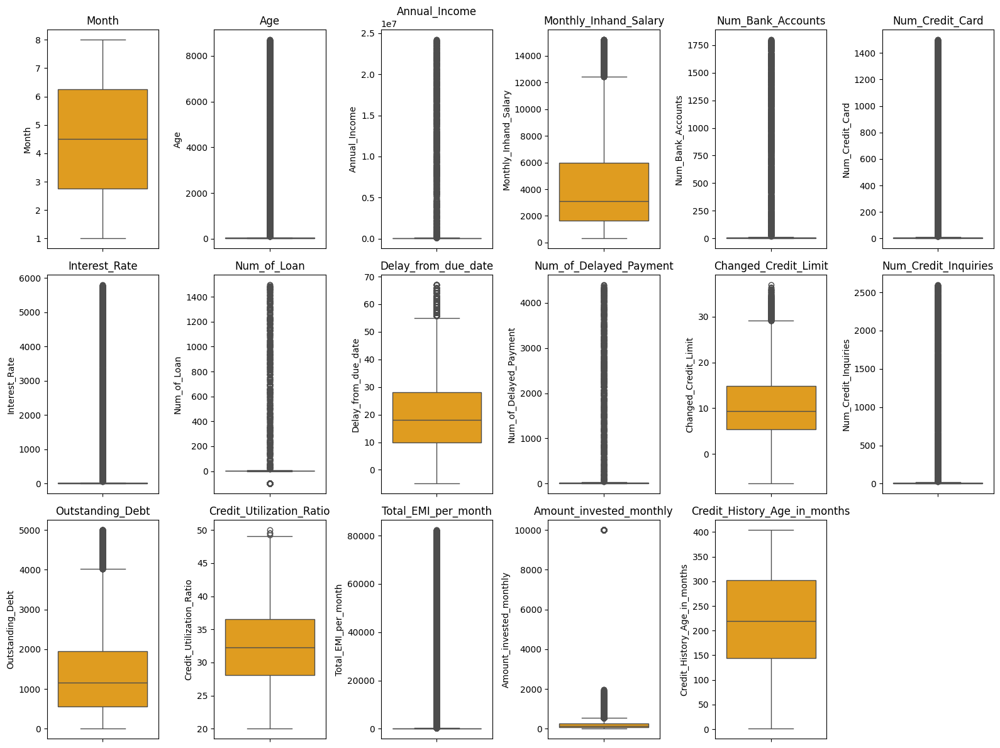

In [152]:
# Numerical features
numeric_columns = df.select_dtypes(include=['number']).columns

# Calculate the number of rows based on the specified number of columns
num_columns = 6
num_rows = (len(numeric_columns) // num_columns) + (1 if len(numeric_columns) % num_columns != 0 else 0)

# Create a figure with specified size
fig, axes = plt.subplots(num_rows, num_columns, figsize=(16, 4 * num_rows))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Plot each numeric column
for x, col in enumerate(numeric_columns):
    sns.boxplot(data=df[col], color='orange', ax=axes[x])
    axes[x].set_title(col)

# Hide any unused axes (if there are any)
for i in range(x + 1, len(axes)):
    axes[i].axis('off')

plt.tight_layout() 
plt.show()

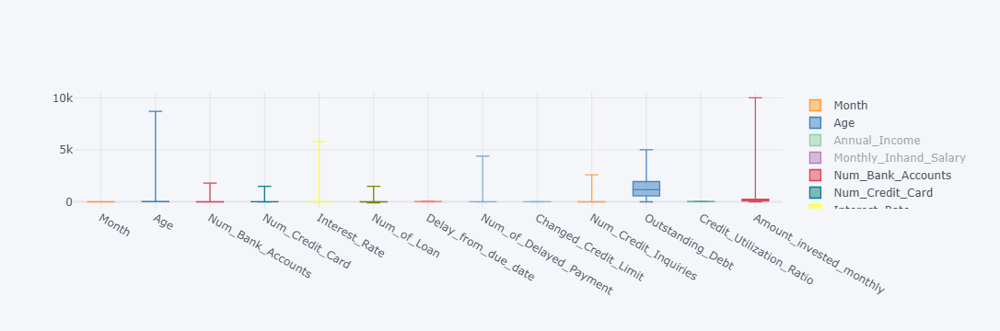

In [164]:
# categorical features
categoric_features = df.select_dtypes(include=['object', 'category']).columns.tolist()

import cufflinks as cf 

cf.go_offline()
df.drop(columns= categoric_features).iloc[:,:-1].iplot(kind="box") # dropped categorical features and took numeric features only

In [166]:
def detect_outliers(df, col_name,tukey=1.5):
    ''' 
    this function detects outliers based on 1.5 time IQR and
    returns the number of lower and uper limit and number of outliers respectively
    '''
    first_quartile = np.percentile(np.array(df[col_name].tolist()), 25)
    third_quartile = np.percentile(np.array(df[col_name].tolist()), 75)
    IQR = third_quartile - first_quartile
                      
    upper_limit = third_quartile+(tukey*IQR)
    lower_limit = first_quartile-(tukey*IQR)
    outlier_count = 0
                      
    for value in df[col_name].tolist():
        if (value < lower_limit) | (value > upper_limit):
            outlier_count +=1
    return lower_limit, upper_limit, outlier_count

In [168]:
threshold = 1.5
out_cols = []

for col in numeric_columns:
    print(
        f"{col}\nlower:{detect_outliers(df, col,threshold)[0]} \nupper:{detect_outliers(df, col,threshold)[1]}\
        \noutlier:{detect_outliers(df, col,threshold)[2]}\n*-*-*-*-*-*-*"
    )
    if detect_outliers(df, col,threshold)[2] > 0 :
        out_cols.append(col)
print(out_cols)  

Month
lower:-2.5 
upper:11.5        
outlier:0
*-*-*-*-*-*-*
Age
lower:-0.5 
upper:67.5        
outlier:2781
*-*-*-*-*-*-*
Annual_Income
lower:-60542.630000000005 
upper:152791.05        
outlier:2783
*-*-*-*-*-*-*
Monthly_Inhand_Salary
lower:-4893.186666666668 
upper:12490.760000000002        
outlier:2141
*-*-*-*-*-*-*
Num_Bank_Accounts
lower:-3.0 
upper:13.0        
outlier:1315
*-*-*-*-*-*-*
Num_Credit_Card
lower:-0.5 
upper:11.5        
outlier:2271
*-*-*-*-*-*-*
Interest_Rate
lower:-10.0 
upper:38.0        
outlier:2034
*-*-*-*-*-*-*
Num_of_Loan
lower:-5.0 
upper:11.0        
outlier:4348
*-*-*-*-*-*-*
Delay_from_due_date
lower:-17.0 
upper:55.0        
outlier:4002
*-*-*-*-*-*-*
Num_of_Delayed_Payment
lower:-6.0 
upper:34.0        
outlier:736
*-*-*-*-*-*-*
Changed_Credit_Limit
lower:-8.91 
upper:29.09        
outlier:726
*-*-*-*-*-*-*
Num_Credit_Inquiries
lower:-6.0 
upper:18.0        
outlier:1751
*-*-*-*-*-*-*
Outstanding_Debt
lower:-1503.7625 
upper:4015.7975        
outlier

In [170]:
# Capping outliers
for col in list(numeric_columns):
    lower, upper, _ = detect_outliers(df, col, threshold)
    df[col] = np.clip(df[col], lower, upper)

In [176]:
# after capping outliers

threshold = 1.5
out_cols = []

for col in numeric_columns:
    print(
        f"{col}\nlower:{detect_outliers(df, col,threshold)[0]} \nupper:{detect_outliers(df, col,threshold)[1]}\
        \noutlier:{detect_outliers(df, col,threshold)[2]}\n*-*-*-*-*-*-*"
    )
    if detect_outliers(df, col,threshold)[2] > 0 :
        out_cols.append(col)
print(out_cols)  

Month
lower:-2.5 
upper:11.5        
outlier:0
*-*-*-*-*-*-*
Age
lower:-0.5 
upper:67.5        
outlier:0
*-*-*-*-*-*-*
Annual_Income
lower:-60542.630000000005 
upper:152791.05        
outlier:0
*-*-*-*-*-*-*
Monthly_Inhand_Salary
lower:-4893.186666666668 
upper:12490.760000000002        
outlier:0
*-*-*-*-*-*-*
Num_Bank_Accounts
lower:-3.0 
upper:13.0        
outlier:0
*-*-*-*-*-*-*
Num_Credit_Card
lower:-0.5 
upper:11.5        
outlier:0
*-*-*-*-*-*-*
Interest_Rate
lower:-10.0 
upper:38.0        
outlier:0
*-*-*-*-*-*-*
Num_of_Loan
lower:-5.0 
upper:11.0        
outlier:0
*-*-*-*-*-*-*
Delay_from_due_date
lower:-17.0 
upper:55.0        
outlier:0
*-*-*-*-*-*-*
Num_of_Delayed_Payment
lower:-6.0 
upper:34.0        
outlier:0
*-*-*-*-*-*-*
Changed_Credit_Limit
lower:-8.91 
upper:29.09        
outlier:0
*-*-*-*-*-*-*
Num_Credit_Inquiries
lower:-6.0 
upper:18.0        
outlier:0
*-*-*-*-*-*-*
Outstanding_Debt
lower:-1503.7625 
upper:4015.7975        
outlier:0
*-*-*-*-*-*-*
Credit_Utiliza

In [178]:
# saving clean data as csv file
df.to_csv("clean_data.csv", index=False)

<a id='modeling'></a>
# <font color='orange'> <b>Modeling</b><font color='black'>  

In [3]:
df = pd.read_csv("clean_data.csv")
df.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,Credit_History_Age_in_months
0,1,23.0,Scientist,19114.12,1824.843333,3,4.0,3,4,3,7.000000,11.270000,4.0,Good,809.98,26.822620,No,49.574949,80.415295,High_spent_Small_value_payments,312.494,Good,265.0
1,2,23.0,Scientist,19114.12,1592.843333,3,4.0,3,4,-1,26.035471,11.270000,4.0,Good,809.98,31.944960,No,49.574949,118.280222,Low_spent_Large_value_payments,284.629,Good,268.5
2,3,67.5,Scientist,19114.12,1592.843333,3,4.0,3,4,3,7.000000,10.103333,4.0,Good,809.98,28.609352,No,49.574949,81.699521,Low_spent_Medium_value_payments,331.210,Good,267.0
3,4,23.0,Scientist,19114.12,1592.843333,3,4.0,3,4,5,4.000000,6.270000,4.0,Good,809.98,31.377862,No,49.574949,199.458074,Low_spent_Small_value_payments,223.451,Good,268.0
4,5,23.0,Scientist,19114.12,1824.843333,3,4.0,3,4,6,26.035471,11.270000,4.0,Good,809.98,24.797347,No,49.574949,41.420153,High_spent_Medium_value_payments,341.489,Good,269.0


<a id='data-preparation'></a>
## <font color='gold'> <b>Data Preparation</b><font color='black'>  

### <font color='sandybrown'> <b>Encoding</b><font color='black'>  

In [5]:
categoric_features = df.select_dtypes(include=['object', 'category']).columns.tolist()
categoric_features

['Occupation',
 'Credit_Mix',
 'Payment_of_Min_Amount',
 'Payment_Behaviour',
 'Credit_Score']

In [7]:
mapping1 = {'No': 0, 'Yes': 1}
df['Payment_of_Min_Amount'] = df['Payment_of_Min_Amount'].map(mapping1)

In [9]:
mapping2 = {'Good': 2, 'Standard': 1, 'Poor': 0}
df['Credit_Score'] = df['Credit_Score'].map(mapping2)

mapping3 = {'Good': 2, 'Standard': 1, 'Bad': 0}
df['Credit_Mix'] = df['Credit_Mix'].map(mapping3)

In [11]:
mapping4 = {
    'High_spent_Small_value_payments': 0,
    'Low_spent_Large_value_payments': 1,
    'Low_spent_Medium_value_payments': 2,
    'Low_spent_Small_value_payments': 3,
    'High_spent_Medium_value_payments': 4,
    'High_spent_Large_value_payments': 5,
}

df['Payment_Behaviour'] = df['Payment_Behaviour'].map(mapping4)

In [13]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder

cat_onehot = ['Occupation']
column_trans = make_column_transformer(
    (OneHotEncoder(handle_unknown='ignore', sparse_output=False), cat_onehot),
    remainder='passthrough'
)

df_encoded = column_trans.fit_transform(df)

In [14]:
features = column_trans.get_feature_names_out()

In [16]:
df_encoded = pd.DataFrame(df_encoded, columns=features, index=df.index)

In [19]:
new_columns = [col.replace('onehotencoder__', '').replace('remainder__', '') for col in df_encoded.columns]
df_encoded.columns = new_columns

df_encoded.head()

,Occupation_Accountant,Occupation_Architect,Occupation_Developer,Occupation_Doctor,Occupation_Engineer,Occupation_Entrepreneur,Occupation_Journalist,Occupation_Lawyer,Occupation_Manager,Occupation_Mechanic,Occupation_Media_Manager,Occupation_Musician,Occupation_Scientist,Occupation_Teacher,Occupation_Writer,Month,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_Score,Credit_History_Age_in_months
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,23.0,19114.12,1824.843333,3.0,4.0,3.0,4.0,3.0,7.000000,11.270000,4.0,2.0,809.98,26.822620,0.0,49.574949,80.415295,0.0,312.494,2.0,265.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2.0,23.0,19114.12,1592.843333,3.0,4.0,3.0,4.0,-1.0,26.035471,11.270000,4.0,2.0,809.98,31.944960,0.0,49.574949,118.280222,1.0,284.629,2.0,268.5
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,3.0,67.5,19114.12,1592.843333,3.0,4.0,3.0,4.0,3.0,7.000000,10.103333,4.0,2.0,809.98,28.609352,0.0,49.574949,81.699521,2.0,331.210,2.0,267.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,4.0,23.0,19114.12,1592.843333,3.0,4.0,3.0,4.0,5.0,4.000000,6.270000,4.0,2.0,809.98,31.377862,0.0,49.574949,199.458074,3.0,223.451,2.0,268.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,5.0,23.0,19114.12,1824.843333,3.0,4.0,3.0,4.0,6.0,26.035471,11.270000,4.0,2.0,809.98,24.797347,0.0,49.574949,41.420153,4.0,341.489,2.0,269.0


In [21]:
# saving encoded df
df_encoded.to_csv("df_encoded.csv", index=False)

### <font color='sandybrown'> <b>Train | Test Split</b><font color='black'>  

In [21]:
df = pd.read_csv("df_encoded.csv")

In [23]:
X = df.drop(columns= "Credit_Score").values
y = df.Credit_Score.values

In [27]:
df.Credit_Score.value_counts()

# unbalanced data

Credit_Score
1.0    53174
0.0    28998
2.0    17828
Name: count, dtype: int64

In [25]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, shuffle= True, random_state=101)

In [27]:
print("X_train size:", X_train.shape)
print("X_test size: ", X_test.shape)

X_train size: (80000, 36)
X_test size:  (20000, 36)


### <font color='sandybrown'> <b>Scaling</b><font color='black'>  

In [29]:
scaler = MinMaxScaler() 

In [31]:
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [39]:
from tensorflow.keras.utils import to_categorical

y_train = to_categorical(y_train, num_classes=3)
y_test = to_categorical(y_test, num_classes=3)

<a id='building-ann'></a>
## <font color='gold'> <b>Building ANN Architectures</b><font color='black'>  

In [138]:
model1 = Sequential()

model1.add(Dense(512, activation="relu", input_dim=36))
model1.add(Dropout(0.2))
model1.add(Dense(256, activation="relu"))
model1.add(Dropout(0.3))
model1.add(Dense(256, activation="relu"))
model1.add(Dense(128, activation="relu"))
model1.add(Dropout(0.2))
model1.add(Dense(3, activation="softmax"))

model1.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [140]:
model1.summary()

Model: "sequential_12"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_50 (Dense)                     │ (None, 512)                 │          18,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_20 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_51 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_21 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_52 (Dense)                     │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_53 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_22 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_54 (Dense)                     │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 249,347 (974.01 KB)

 Trainable params: 249,347 (974.01 KB)

 Non-trainable params: 0 (0.00 B)

In [142]:
from tensorflow.keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20)

In [144]:
model1.fit(X_train, y_train, batch_size = 256, epochs = 800, validation_data=(X_test, y_test), callbacks=[early_stopping])

Epoch 1/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 4s 7ms/step - accuracy: 0.6583 - loss: 0.7554 - val_accuracy: 0.7247 - val_loss: 0.6247
Epoch 2/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7214 - loss: 0.6295 - val_accuracy: 0.7251 - val_loss: 0.6137
Epoch 3/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7292 - loss: 0.6039 - val_accuracy: 0.7328 - val_loss: 0.6022
Epoch 4/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7301 - loss: 0.6005 - val_accuracy: 0.7362 - val_loss: 0.5929
Epoch 5/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7350 - loss: 0.5892 - val_accuracy: 0.7354 - val_loss: 0.5874
Epoch 6/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7391 - loss: 0.5811 - val_accuracy: 0.7381 - val_loss: 0.5843
Epoch 7/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7400 - loss: 0.5770 - val_accuracy: 0.7400 - val_loss: 0.5796
Epoch 8/800
313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 6ms/step - accuracy: 0.7414 - loss: 0.5747 - val_accu

In [152]:
model1.save("ann-1.keras")

In [146]:
summary = pd.DataFrame(model1.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss
0,0.692738,0.691952,0.72465,0.624716
1,0.721462,0.624953,0.72510,0.613679
2,0.728175,0.606777,0.73280,0.602209
3,0.731775,0.597019,0.73620,0.592946
4,0.735363,0.588797,0.73535,0.587383


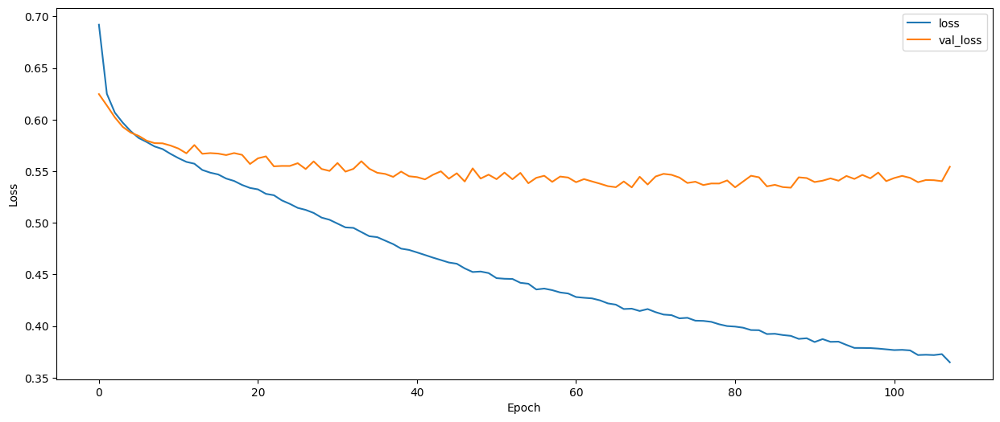

In [148]:
plt.figure(figsize=(15, 6))
plt.plot(summary.loss, label="loss")
plt.plot(summary.val_loss, label="val_loss")
plt.legend(loc="upper right")
plt.ylabel("Loss")
plt.xlabel("Epoch")
plt.show()

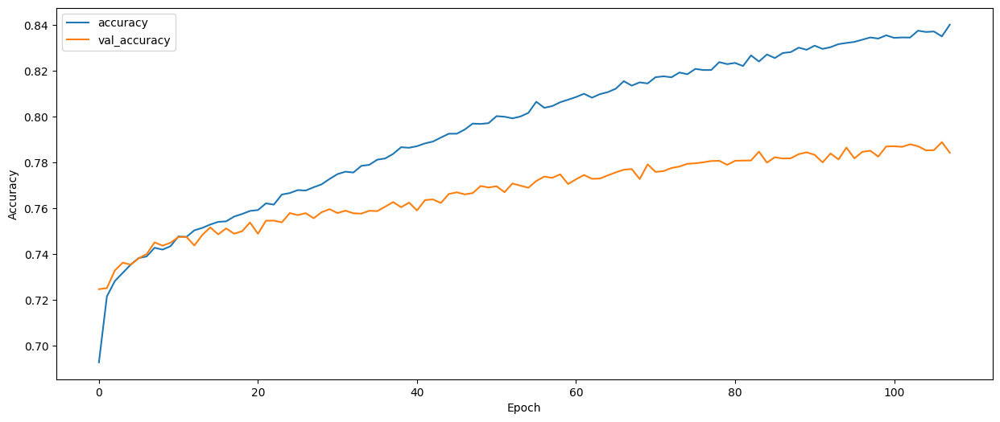

In [150]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [110]:
from tensorflow.keras.layers import BatchNormalization

model2 = Sequential()

model2.add(Dense(512, activation="relu", input_dim=36))
model2.add(BatchNormalization())
model2.add(Dropout(0.2))
model2.add(Dense(512, activation="relu"))
model2.add(BatchNormalization())
model2.add(Dropout(0.3))
model2.add(Dense(256, activation="relu"))
model2.add(BatchNormalization())
model2.add(Dropout(0.2))
model2.add(Dense(128, activation="relu"))
model2.add(Dense(64, activation="relu"))
model2.add(Dropout(0.3))
model2.add(Dense(3, activation="softmax"))

model2.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [112]:
model2.summary()

Model: "sequential_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_36 (Dense)                     │ (None, 512)                 │          18,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_6                │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_11 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_37 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_7                │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_12 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_38 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_8                │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_13 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_39 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_40 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_14 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_41 (Dense)                     │ (None, 3)                   │             195 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 459,395 (1.75 MB)

 Trainable params: 456,835 (1.74 MB)

 Non-trainable params: 2,560 (10.00 KB)

In [116]:
model2.fit(X_train, y_train, batch_size = 512, epochs = 800, validation_data=(X_test, y_test), callbacks=[early_stopping])

Epoch 1/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 8s 51ms/step - accuracy: 0.6165 - loss: 0.8404 - val_accuracy: 0.6132 - val_loss: 0.8268
Epoch 2/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 42ms/step - accuracy: 0.7199 - loss: 0.6360 - val_accuracy: 0.6413 - val_loss: 0.7043
Epoch 3/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - accuracy: 0.7198 - loss: 0.6200 - val_accuracy: 0.7249 - val_loss: 0.6118
Epoch 4/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - accuracy: 0.7316 - loss: 0.5999 - val_accuracy: 0.7322 - val_loss: 0.5897
Epoch 5/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - accuracy: 0.7350 - loss: 0.5924 - val_accuracy: 0.7361 - val_loss: 0.5848
Epoch 6/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 45ms/step - accuracy: 0.7376 - loss: 0.5838 - val_accuracy: 0.7400 - val_loss: 0.5837
Epoch 7/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - accuracy: 0.7397 - loss: 0.5800 - val_accuracy: 0.7373 - val_loss: 0.5826
Epoch 8/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - accuracy: 0.7404 - loss: 0.5782 - 

In [126]:
model2.save("ann-2.keras")

In [118]:
summary = pd.DataFrame(model2.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss
0,0.674800,0.726892,0.61315,0.826817
1,0.719200,0.630443,0.64135,0.704303
2,0.723425,0.613970,0.72490,0.611760
3,0.730663,0.601776,0.73225,0.589674
4,0.732325,0.595118,0.73610,0.584830


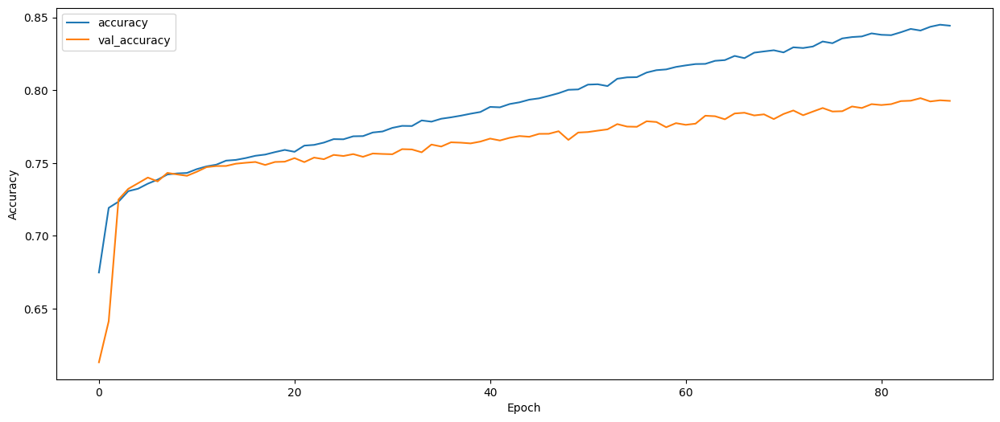

In [120]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [122]:
model3 = Sequential()

model3.add(Dense(1024, activation="relu", input_dim=36))
model3.add(BatchNormalization())
model3.add(Dropout(0.2))

model3.add(Dense(512, activation="relu"))
model3.add(BatchNormalization())
model3.add(Dropout(0.3))

model3.add(Dense(512, activation="relu"))
model3.add(BatchNormalization())
model3.add(Dropout(0.3))

model3.add(Dense(256, activation="relu"))
model3.add(BatchNormalization())
model3.add(Dropout(0.2))

model3.add(Dense(256, activation="relu"))
model3.add(Dense(128, activation="relu"))
model3.add(Dense(64, activation="relu"))
model3.add(Dropout(0.3))
model3.add(Dense(3, activation="softmax"))

model3.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [124]:
model3.summary()

Model: "sequential_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_42 (Dense)                     │ (None, 1024)                │          37,888 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_9                │ (None, 1024)                │           4,096 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_15 (Dropout)                 │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_43 (Dense)                     │ (None, 512)                 │         524,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_10               │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_16 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_44 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_11               │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_17 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_45 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_12               │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_18 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_46 (Dense)                     │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_47 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_48 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_19 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_49 (Dense)                     │ (None, 3)                   │             195 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,073,027 (4.09 MB)

 Trainable params: 1,068,419 (4.08 MB)

 Non-trainable params: 4,608 (18.00 KB)

In [128]:
model3.fit(X_train, y_train, batch_size = 1000, epochs = 800, validation_data=(X_test, y_test), callbacks=[early_stopping])

Epoch 1/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 17s 121ms/step - accuracy: 0.6086 - loss: 0.8326 - val_accuracy: 0.6006 - val_loss: 0.8596
Epoch 2/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 111ms/step - accuracy: 0.7201 - loss: 0.6347 - val_accuracy: 0.5588 - val_loss: 0.9292
Epoch 3/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 111ms/step - accuracy: 0.7312 - loss: 0.6081 - val_accuracy: 0.5908 - val_loss: 0.9525
Epoch 4/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 108ms/step - accuracy: 0.7360 - loss: 0.5958 - val_accuracy: 0.6201 - val_loss: 0.7994
Epoch 5/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.7367 - loss: 0.5932 - val_accuracy: 0.6430 - val_loss: 0.7259
Epoch 6/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 109ms/step - accuracy: 0.7363 - loss: 0.5866 - val_accuracy: 0.7012 - val_loss: 0.6271
Epoch 7/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 112ms/step - accuracy: 0.7414 - loss: 0.5818 - val_accuracy: 0.7402 - val_loss: 0.5917
Epoch 8/800
80/80 ━━━━━━━━━━━━━━━━━━━━ 9s 111ms/step - accuracy: 0.7406 - loss: 0.5774 - val_acc

In [136]:
model3.save("ann-3.keras")

In [132]:
summary = pd.DataFrame(model3.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss
0,0.675425,0.719124,0.60060,0.859571
1,0.721400,0.629134,0.55885,0.929200
2,0.729350,0.609094,0.59080,0.952487
3,0.733688,0.599406,0.62005,0.799411
4,0.735350,0.593107,0.64300,0.725886


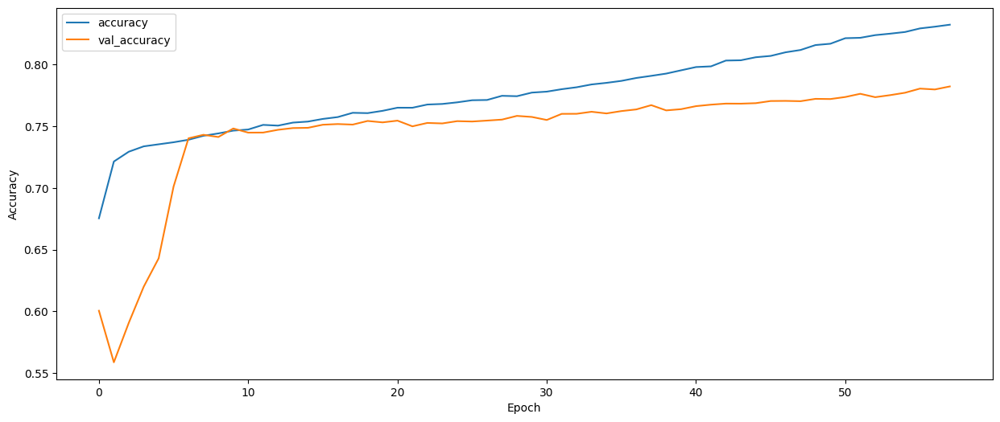

In [134]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [154]:
from tensorflow.keras.layers import LeakyReLU

model4 = Sequential()

model4.add(Dense(1024, input_dim=36))
model4.add(LeakyReLU(alpha=0.1))
model4.add(BatchNormalization())
model4.add(Dropout(0.2))

model4.add(Dense(512))
model4.add(LeakyReLU(alpha=0.1))
model4.add(BatchNormalization())
model4.add(Dropout(0.3))

model4.add(Dense(512))
model4.add(LeakyReLU(alpha=0.1))
model4.add(BatchNormalization())
model4.add(Dropout(0.3))

model4.add(Dense(256))
model4.add(LeakyReLU(alpha=0.1))
model4.add(BatchNormalization())
model4.add(Dropout(0.2))

model4.add(Dense(256))
model4.add(LeakyReLU(alpha=0.1))
model4.add(Dense(128))
model4.add(LeakyReLU(alpha=0.1))
model4.add(Dense(64))
model4.add(LeakyReLU(alpha=0.1))
model4.add(Dropout(0.3))
model4.add(Dense(3, activation="softmax"))

model4.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [166]:
model4.summary()

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_55 (Dense)                     │ (None, 1024)                │          37,888 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_13               │ (None, 1024)                │           4,096 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_23 (Dropout)                 │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_56 (Dense)                     │ (None, 512)                 │         524,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_14               │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_24 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_57 (Dense)                     │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_15               │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_25 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_58 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_16               │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_26 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_59 (Dense)                     │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_60 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 3,209,867 (12.24 MB)

 Trainable params: 1,068,419 (4.08 MB)

 Non-trainable params: 4,608 (18.00 KB)

 Optimizer params: 2,136,840 (8.15 MB)

In [156]:
model4.fit(X_train, y_train, batch_size = 2000, epochs = 800, validation_data=(X_test, y_test), callbacks=[early_stopping])

Epoch 1/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 8s 109ms/step - accuracy: 0.6050 - loss: 0.8407 - val_accuracy: 0.5965 - val_loss: 0.8739
Epoch 2/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - accuracy: 0.7172 - loss: 0.6423 - val_accuracy: 0.5551 - val_loss: 0.8413
Epoch 3/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 99ms/step - accuracy: 0.7225 - loss: 0.6187 - val_accuracy: 0.5369 - val_loss: 0.9111
Epoch 4/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step - accuracy: 0.7275 - loss: 0.6051 - val_accuracy: 0.5428 - val_loss: 0.8763
Epoch 5/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 97ms/step - accuracy: 0.7295 - loss: 0.5949 - val_accuracy: 0.5376 - val_loss: 0.9348
Epoch 6/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 98ms/step - accuracy: 0.7343 - loss: 0.5903 - val_accuracy: 0.5732 - val_loss: 0.9895
Epoch 7/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 100ms/step - accuracy: 0.7390 - loss: 0.5837 - val_accuracy: 0.5750 - val_loss: 0.9440
Epoch 8/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 4s 101ms/step - accuracy: 0.7396 - loss: 0.5806 - val_accuracy

In [158]:
model4.save("ann-4.keras")

In [160]:
summary = pd.DataFrame(model4.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss
0,0.668950,0.731883,0.59655,0.873914
1,0.719362,0.632804,0.55510,0.841305
2,0.723312,0.615560,0.53690,0.911143
3,0.728125,0.604367,0.54280,0.876284
4,0.728925,0.595733,0.53760,0.934765


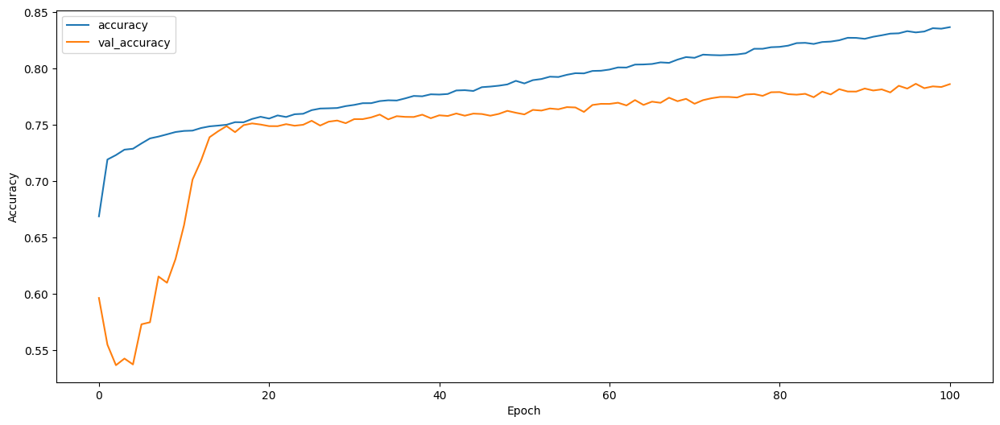

In [161]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [41]:
y_train = np.argmax(y_train, axis=1)
y_test = np.argmax(y_test, axis=1)

In [45]:
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.layers import BatchNormalization

model4_2 = Sequential()

model4_2.add(Dense(1024, input_dim=36))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(BatchNormalization())
model4_2.add(Dropout(0.2))

model4_2.add(Dense(512))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(BatchNormalization())
model4_2.add(Dropout(0.3))

model4_2.add(Dense(512))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(BatchNormalization())
model4_2.add(Dropout(0.3))

model4_2.add(Dense(256))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(BatchNormalization())
model4_2.add(Dropout(0.2))

model4_2.add(Dense(256))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(Dense(128))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(Dense(64))
model4_2.add(LeakyReLU(alpha=0.1))
model4_2.add(Dropout(0.3))
model4_2.add(Dense(3, activation="softmax"))

model4_2.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

In [47]:
model4_2.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_1 (Dense)                      │ (None, 1024)                │          37,888 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 1024)                │           4,096 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 1024)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 512)                 │         524,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 512)                 │         262,656 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_3 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_5 (LeakyReLU)            │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 1,073,027 (4.09 MB)

 Trainable params: 1,068,419 (4.08 MB)

 Non-trainable params: 4,608 (18.00 KB)

In [52]:
from tensorflow.keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=70)

In [54]:
model4_2.fit(X_train, y_train, batch_size = 2000, epochs = 800, validation_data=(X_test, y_test), callbacks=[early_stopping])

Epoch 1/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 15s 194ms/step - accuracy: 0.6163 - loss: 0.8239 - val_accuracy: 0.6179 - val_loss: 0.8541
Epoch 2/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 176ms/step - accuracy: 0.7181 - loss: 0.6368 - val_accuracy: 0.6046 - val_loss: 0.8440
Epoch 3/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 175ms/step - accuracy: 0.7248 - loss: 0.6152 - val_accuracy: 0.5598 - val_loss: 0.9319
Epoch 4/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 178ms/step - accuracy: 0.7248 - loss: 0.6107 - val_accuracy: 0.5418 - val_loss: 0.9935
Epoch 5/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 178ms/step - accuracy: 0.7305 - loss: 0.5958 - val_accuracy: 0.5612 - val_loss: 0.9800
Epoch 6/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 178ms/step - accuracy: 0.7344 - loss: 0.5927 - val_accuracy: 0.5717 - val_loss: 0.9474
Epoch 7/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 177ms/step - accuracy: 0.7384 - loss: 0.5833 - val_accuracy: 0.6037 - val_loss: 0.9399
Epoch 8/800
40/40 ━━━━━━━━━━━━━━━━━━━━ 7s 179ms/step - accuracy: 0.7411 - loss: 0.5761 - val_acc

In [56]:
model4_2.save("ann-4.2.keras")

In [60]:
summary = pd.DataFrame(model4_2.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss
0,0.672950,0.727840,0.61790,0.854081
1,0.720438,0.632068,0.60460,0.844041
2,0.725088,0.614133,0.55975,0.931865
3,0.728750,0.604700,0.54185,0.993533
4,0.731138,0.595790,0.56120,0.979964


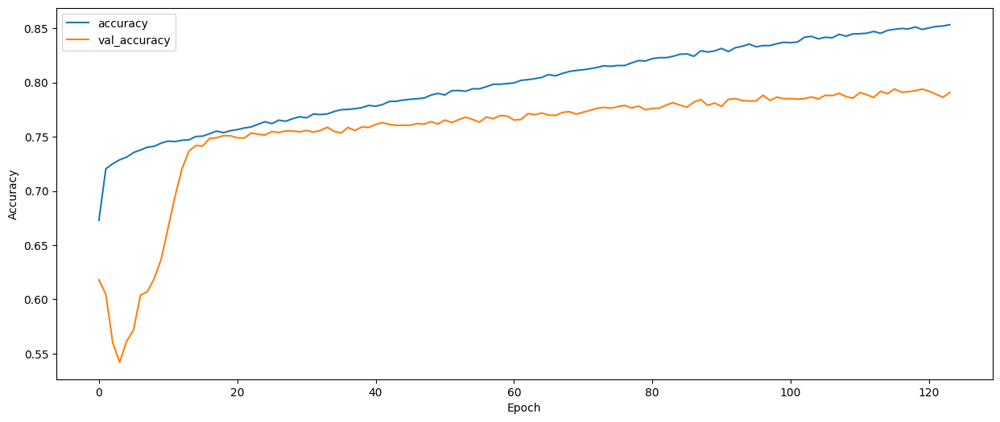

In [62]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [180]:
from keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau

model5 = Sequential()

model5.add(Dense(512, input_dim=36, activation='relu'))
model5.add(Dropout(0.3))

model5.add(Dense(256, activation='relu'))
model5.add(Dropout(0.3))

model5.add(Dense(128, activation='relu'))
model5.add(Dropout(0.2))

model5.add(Dense(128, activation='relu'))
model5.add(Dropout(0.3))

model5.add(Dense(128, activation='relu'))
model5.add(Dropout(0.2))

model5.add(Dense(64, activation='relu'))

model5.add(Dense(3, activation='softmax'))

model5.compile(optimizer = Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics = ['accuracy'])

early_stopping = EarlyStopping(monitor='val_accuracy', patience=70, restore_best_weights=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=0.0001)

In [182]:
model5.summary()

Model: "sequential_17"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_77 (Dense)                     │ (None, 512)                 │          18,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_38 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_78 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_39 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_79 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_40 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_80 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_41 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_81 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_42 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_82 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_83 (Dense)                     │ (None, 3)                   │             195 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 224,643 (877.51 KB)

 Trainable params: 224,643 (877.51 KB)

 Non-trainable params: 0 (0.00 B)

In [184]:
model5.fit(X_train, y_train, batch_size = 3000, epochs = 800, validation_data=(X_test, y_test), callbacks=[early_stopping, reduce_lr])

Epoch 1/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.5137 - loss: 0.9790 - val_accuracy: 0.6793 - val_loss: 0.7528 - learning_rate: 0.0010
Epoch 2/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.6526 - loss: 0.7641 - val_accuracy: 0.7031 - val_loss: 0.6786 - learning_rate: 0.0010
Epoch 3/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.6967 - loss: 0.6902 - val_accuracy: 0.7104 - val_loss: 0.6548 - learning_rate: 0.0010
Epoch 4/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.7097 - loss: 0.6621 - val_accuracy: 0.7211 - val_loss: 0.6373 - learning_rate: 0.0010
Epoch 5/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 31ms/step - accuracy: 0.7154 - loss: 0.6435 - val_accuracy: 0.7241 - val_loss: 0.6261 - learning_rate: 0.0010
Epoch 6/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 32ms/step - accuracy: 0.7199 - loss: 0.6350 - val_accuracy: 0.7226 - val_loss: 0.6178 - learning_rate: 0.0010
Epoch 7/800
27/27 ━━━━━━━━━━━━━━━━━━━━ 1s 30ms/step - accuracy: 0.7191 - loss: 0.6266 - 

In [186]:
model5.save("ann-5.keras")

In [188]:
summary = pd.DataFrame(model5.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss,learning_rate
0,0.555488,0.907130,0.67925,0.752841,0.001
1,0.666750,0.743113,0.70315,0.678628,0.001
2,0.697925,0.686225,0.71045,0.654804,0.001
3,0.709975,0.657776,0.72115,0.637310,0.001
4,0.715563,0.641652,0.72410,0.626145,0.001


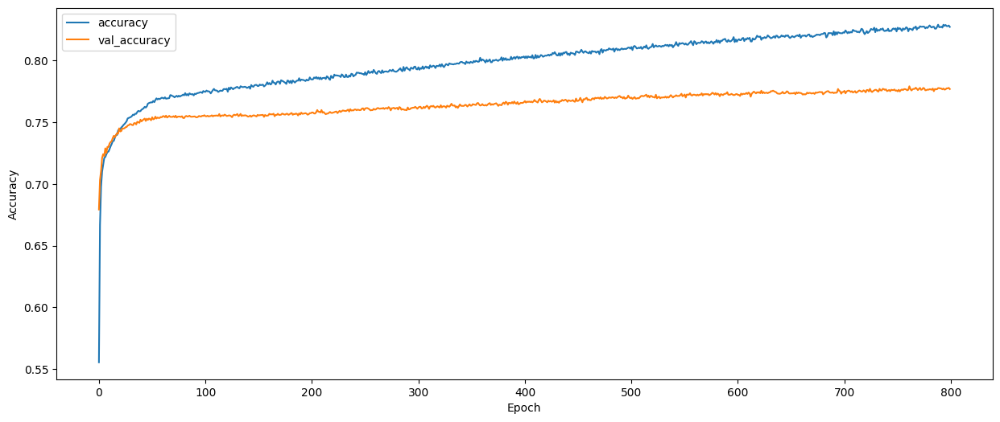

In [190]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [192]:
model6 = Sequential([
    Dense(512, input_dim=X_train.shape[1], activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation='relu'),
    BatchNormalization(),
    Dropout(0.3),
    Dense(256, activation='relu'),
    BatchNormalization(),
    Dropout(0.2),
    Dense(128, activation='relu'), 
    BatchNormalization(),
    Dropout(0.3),
    Dense(128, activation='relu'),
    BatchNormalization(),
    Dropout(0.2),
    Dense(64, activation='relu'),
    BatchNormalization(),
    Dropout(0.25),
    Dense(3, activation='softmax')
])

y_train = np.argmax(y_train, axis=1)
y_test = np.argmax(y_test, axis=1)

model6.compile(optimizer = Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics = ['accuracy'])

early_stopping = EarlyStopping(monitor='val_accuracy', patience=70, restore_best_weights=True)

In [194]:
model6.summary()

Model: "sequential_18"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense_84 (Dense)                     │ (None, 512)                 │          18,944 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_17               │ (None, 512)                 │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_43 (Dropout)                 │ (None, 512)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_85 (Dense)                     │ (None, 256)                 │         131,328 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_18               │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_44 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_86 (Dense)                     │ (None, 256)                 │          65,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_19               │ (None, 256)                 │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_45 (Dropout)                 │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_87 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_20               │ (None, 128)                 │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_46 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_88 (Dense)                     │ (None, 128)                 │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_21               │ (None, 128)                 │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_47 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_89 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_22               │ (None, 64)                  │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_48 (Dropout)                 │ (None, 64)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 279,299 (1.07 MB)

 Trainable params: 276,611 (1.06 MB)

 Non-trainable params: 2,688 (10.50 KB)

In [196]:
model6.fit(x=X_train, y=y_train, validation_data=(X_test, y_test), validation_split=0.1, batch_size=512, epochs=800, verbose=1, callbacks=[early_stopping])

Epoch 1/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 7s 17ms/step - accuracy: 0.5303 - loss: 1.1296 - val_accuracy: 0.5318 - val_loss: 0.9890
Epoch 2/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.6918 - loss: 0.7144 - val_accuracy: 0.6235 - val_loss: 0.7538
Epoch 3/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7038 - loss: 0.6667 - val_accuracy: 0.7254 - val_loss: 0.6290
Epoch 4/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 13ms/step - accuracy: 0.7146 - loss: 0.6412 - val_accuracy: 0.7270 - val_loss: 0.6133
Epoch 5/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7190 - loss: 0.6295 - val_accuracy: 0.7261 - val_loss: 0.6065
Epoch 6/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7225 - loss: 0.6208 - val_accuracy: 0.7269 - val_loss: 0.6003
Epoch 7/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7263 - loss: 0.6110 - val_accuracy: 0.7276 - val_loss: 0.5961
Epoch 8/800
157/157 ━━━━━━━━━━━━━━━━━━━━ 2s 14ms/step - accuracy: 0.7288 - loss: 0.6053 - 

In [198]:
model6.save("ann-6.keras")

In [200]:
summary = pd.DataFrame(model6.history.history)
summary.head()

,accuracy,loss,val_accuracy,val_loss
0,0.610838,0.934789,0.53175,0.989036
1,0.695550,0.698368,0.62350,0.753779
2,0.707738,0.658508,0.72540,0.629008
3,0.716637,0.636487,0.72700,0.613282
4,0.719463,0.626907,0.72605,0.606493


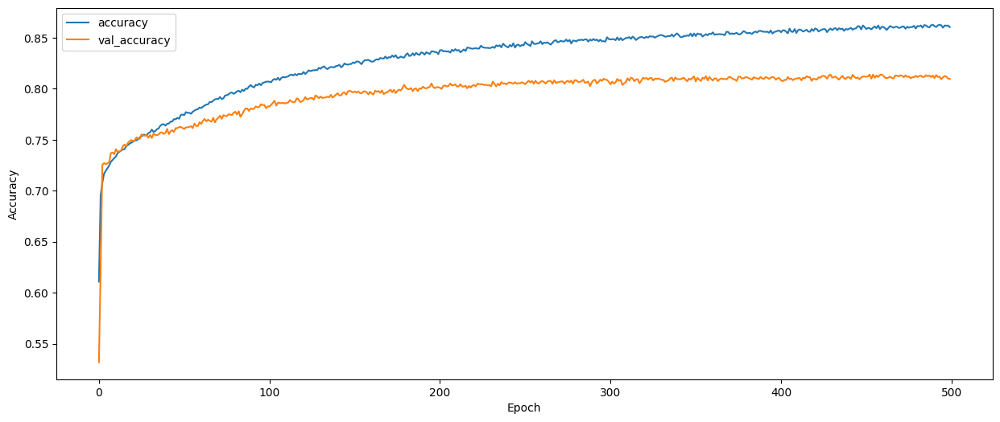

In [202]:
plt.figure(figsize=(15, 6))
plt.plot(summary.accuracy, label="accuracy")
plt.plot(summary.val_accuracy, label="val_accuracy")
plt.legend(loc="upper left")
plt.ylabel("Accuracy")
plt.xlabel("Epoch")
plt.show()

In [205]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

In [211]:
score = model6.evaluate(X_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 0.4934215843677521
Test accuracy: 0.8139500021934509


In [213]:
preds = model6.predict(X_test)
predictions= np.argmax(preds, axis=1)

625/625 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


In [216]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.78      0.83      0.80      5799
           1       0.85      0.81      0.83     10635
           2       0.78      0.79      0.79      3566

    accuracy                           0.81     20000
   macro avg       0.80      0.81      0.81     20000
weighted avg       0.82      0.81      0.81     20000



In [219]:
print(confusion_matrix(y_test, predictions))

[[4819  890   90]
 [1295 8634  706]
 [  67  673 2826]]


In [238]:
my_dict = {"Actual" : y_test, "Pred" : predictions.reshape(-1,)}
compare = pd.DataFrame(my_dict)
compare.sample(10)

,Actual,Pred
2701,1,1
10988,1,1
11984,0,0
14294,1,1
4074,1,2
18840,1,1
10550,1,0
1582,1,1
4554,2,2
12051,2,1


These results indicate that the model maintains a balanced performance across all classes and demonstrates strong predictive power. The accuracy and F1-score values are the best among all the models I previously tested. Therefore, **I have decided to finalize this architecture as my final model**.

In [241]:
model6.save("final_model.keras")

<a id='final-model'></a>
# <font color='orange'> <b>Final Model & Prediction</b><font color='black'>  

<a id='test-data-preparation'></a>
## <font color='gold'> <b>Test Data Preparation</b><font color='black'>  

In [98]:
from tensorflow.keras.models import load_model

new_model = load_model('final_model.keras')

In [100]:
df_test = pd.read_csv("testdata_v1.csv")

In [102]:
df_test.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_History_Age_in_months
0,9,23,Scientist,19114.12,1824.843333,3,4,3,4,3,7.0,11.27,2022.0,Good,809.98,35.030402,No,49.574949,236.642682,Low_spent_Small_value_payments,186.267,273.0
1,10,24,Scientist,19114.12,1824.843333,3,4,3,4,3,9.0,13.27,4.0,Good,809.98,33.053114,No,49.574949,21.465380,High_spent_Medium_value_payments,361.444,274.0
2,11,24,Scientist,19114.12,1824.843333,3,4,3,4,-1,4.0,12.27,4.0,Good,809.98,33.811894,No,49.574949,148.233938,Low_spent_Medium_value_payments,264.675,NaN
3,12,24,Scientist,19114.12,NaN,3,4,3,4,4,5.0,11.27,4.0,Good,809.98,32.430559,No,49.574949,39.082511,High_spent_Medium_value_payments,343.827,276.0
4,9,28,NaN,34847.84,3037.986667,2,4,6,1,3,1.0,5.42,5.0,Good,605.03,25.926822,No,18.816215,39.684018,High_spent_Large_value_payments,485.298,327.0


In [104]:
df_test.dropna(inplace=True)

In [106]:
mapping1 = {'No': 0, 'Yes': 1}
df_test['Payment_of_Min_Amount'] = df_test['Payment_of_Min_Amount'].map(mapping1)

In [108]:
mapping3 = {'Good': 2, 'Standard': 1, 'Bad': 0}
df_test['Credit_Mix'] = df_test['Credit_Mix'].map(mapping3)

In [110]:
mapping4 = {
    'High_spent_Small_value_payments': 0,
    'Low_spent_Large_value_payments': 1,
    'Low_spent_Medium_value_payments': 2,
    'Low_spent_Small_value_payments': 3,
    'High_spent_Medium_value_payments': 4,
    'High_spent_Large_value_payments': 5,
}

df_test['Payment_Behaviour'] = df_test['Payment_Behaviour'].map(mapping4)

In [112]:
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import OneHotEncoder

cat_onehot = ['Occupation']
column_trans = make_column_transformer(
    (OneHotEncoder(handle_unknown='ignore', sparse_output=False), cat_onehot),
    remainder='passthrough'
)

df_test_encoded = column_trans.fit_transform(df_test)

In [114]:
features = column_trans.get_feature_names_out()

In [116]:
df_test_encoded = pd.DataFrame(df_test_encoded, columns=features, index=df_test.index)

In [120]:
new_columns = [col.replace('onehotencoder__', '').replace('remainder__', '') for col in df_test_encoded.columns]
df_test_encoded.columns = new_columns

In [123]:
scaler = MinMaxScaler()

In [127]:
df_test_scaled = scaler.fit_transform(df_test_encoded)

<a id='prediction'></a>
## <font color='gold'> <b>Prediction</b><font color='black'>  

In [136]:
predictions = new_model.predict(df_test_scaled)
predicted_classes = np.argmax(predictions, axis=1)

701/701 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step


In [138]:
df_test['Credit_score'] = predicted_classes

In [140]:
label_mapping = {0: 'Bad', 1: 'Standard', 2: 'Good'}
df_test['Credit_score'] = df_test['Credit_score'].map(label_mapping)

In [144]:
df_test.head()

,Month,Age,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Changed_Credit_Limit,Num_Credit_Inquiries,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Payment_of_Min_Amount,Total_EMI_per_month,Amount_invested_monthly,Payment_Behaviour,Monthly_Balance,Credit_History_Age_in_months,Credit_score
0,9,23,Scientist,19114.12,1824.843333,3,4,3,4,3,7.0,11.27,2022.0,2,809.98,35.030402,0,49.574949,236.642682,3,186.267,273.0,Good
1,10,24,Scientist,19114.12,1824.843333,3,4,3,4,3,9.0,13.27,4.0,2,809.98,33.053114,0,49.574949,21.465380,4,361.444,274.0,Good
5,10,28,Teacher,34847.84,3037.986667,2,4,6,1,3,3.0,5.42,5.0,2,605.03,30.116600,0,18.816215,251.627369,1,303.355,328.0,Good
9,10,35,Engineer,143162.64,12187.220000,1,5,8,3,6,3.0,2.10,3.0,2,1303.01,35.685836,0,246.992319,453.615131,1,788.115,222.0,Good
10,11,35,Engineer,143162.64,12187.220000,1,5,8,1381,8,5.0,7.10,5.0,2,1303.01,31.819845,0,246.992319,841.232236,2,410.497,223.0,Good


<a id='conclusion'></a>
# <font color='orange'> <b>Conclusion</b><font color='black'>  

In this study, an Artificial Neural Network (ANN) model was developed to predict individuals' credit scores. The model achieved an **accuracy of 81.4%** on the test set, and a detailed performance analysis was conducted using precision, recall, and F1-score metrics.

The results demonstrate that ANN models provide an effective approach for credit score prediction. However, further improvements can be made by expanding the dataset, testing different model architectures, and performing hyperparameter optimization. In the future, the model can be enhanced with additional financial data to further improve its accuracy.

<p style="background-color:orange;font-family:newtimeroman;font-size:200%;color:black;text-align:center;border-radius:60px 20px;"><b>THANK YOU!</b></p>